# <font color=darkblue>Machine Learning Project: Kidney Disease </font>


**Team Members:**
* Omar M'rad    
* Eya Bouzaiene
* Mayssa Bouzide
* Helmi Dridi
* Fatma Lina Ben Ali
* Wided yacoubi

**Class:** 
4DS6

In [1]:
import pandas as pd
import numpy as np

#! pip install lux-api

from dataprep.eda import create_report
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier, StackingClassifier
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import pointbiserialr
from math import sqrt
from sklearn.model_selection import cross_val_score
from sklearn import svm
import time
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV,cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import precision_recall_fscore_support
#Import k-Nearest Neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,f1_score,roc_curve, auc 
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score
from sklearn.svm import SVC, NuSVC
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import StackingClassifier, VotingClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import inspect 
import sklearn
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.ensemble import BaggingClassifier


from sklearn import metrics
from sklearn.metrics import (confusion_matrix, precision_recall_curve, auc, roc_curve, recall_score, 
                             classification_report, f1_score, accuracy_score, average_precision_score, precision_recall_fscore_support)

import warnings
warnings.filterwarnings('ignore')

# <font color=red>Loading the dataset </font>


In [2]:
data = []
with open('chronic_kidney_disease.arff', "r") as f:
    for line in f:
        line = line.replace('\n', '')
        data.append(line.split(','))


names = ['age', 'bp', 'sg', 'al', 'su', 'rbc', 'pc', 'pcc', 'ba',
         'bgr', 'bu',  'sc', 'sod', 'pot', 'hemo', 'pcv', 'wbcc',
         'rbcc', 'htn', 'dm', 'cad', 'appet', 'pe', 'ane',
         'class','no_name']
    
df = pd.DataFrame(data[29:], columns=names)
df

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,wbcc,rbcc,htn,dm,cad,appet,pe,ane,class,no_name
0,48,80,1.020,1,0,?,normal,notpresent,notpresent,121,...,7800,5.2,yes,yes,no,good,no,no,ckd,None
1,7,50,1.020,4,0,?,normal,notpresent,notpresent,?,...,6000,?,no,no,no,good,no,no,ckd,None
2,62,80,1.010,2,3,normal,normal,notpresent,notpresent,423,...,7500,?,no,yes,no,poor,no,yes,ckd,None
3,48,70,1.005,4,0,normal,abnormal,present,notpresent,117,...,6700,3.9,yes,no,no,poor,yes,yes,ckd,None
4,51,80,1.010,2,0,normal,normal,notpresent,notpresent,106,...,7300,4.6,no,no,no,good,no,no,ckd,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396,42,70,1.025,0,0,normal,normal,notpresent,notpresent,75,...,7800,6.2,no,no,no,good,no,no,notckd,None
397,12,80,1.020,0,0,normal,normal,notpresent,notpresent,100,...,6600,5.4,no,no,no,good,no,no,notckd,None
398,17,60,1.025,0,0,normal,normal,notpresent,notpresent,114,...,7200,5.9,no,no,no,good,no,no,notckd,None
399,58,80,1.025,0,0,normal,normal,notpresent,notpresent,131,...,6800,6.1,no,no,no,good,no,no,notckd,None


In [3]:
del df["no_name"]
data_kidney = df.dropna(axis=0);


# Data Understanding

  0%|          | 0/3467 [00:00<?, ?it/s]


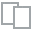
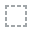
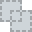
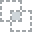
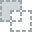
...
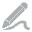
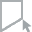
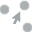
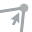
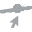

In [10]:
create_report(data_kidney).show()

In [4]:
data_kidney.loc[data_kidney['class'] == "ckd\t", 'class'] = "ckd"
data_kidney.loc[data_kidney['class'] == "no", 'class'] = "notckd"
data_kidney.loc[data_kidney['appet'] == "no", 'appet'] ="poor"
data_kidney.loc[data_kidney['pe'] == "good", 'pe'] ="no"
data_kidney.loc[data_kidney['pcv'] == "\t43", 'pcv'] ="43"
data_kidney.loc[data_kidney['pcv'] == "\t?", 'pcv'] ="?"
data_kidney.loc[data_kidney['wbcc'] == "\t8400", 'wbcc'] ="8400"
data_kidney.loc[data_kidney['wbcc'] == "\t6200", 'wbcc'] ="6200"
data_kidney.loc[data_kidney['wbcc'] == "\t?", 'wbcc'] ="?"
data_kidney.loc[data_kidney['rbcc'] == "\t?", 'rbcc'] ="?"
data_kidney.loc[data_kidney['dm'] == "\tno",'dm'] ="no"
data_kidney.loc[data_kidney['dm'] == "\tyes",'dm'] ="yes"
data_kidney.loc[data_kidney['dm'] == " yes",'dm'] ="yes"
data_kidney.loc[data_kidney['dm'] == "",'dm'] ="?"
data_kidney.loc[data_kidney['cad'] == "\tno",'cad'] ="no"

In [5]:
data_kidney.dtypes

age      object
bp       object
sg       object
al       object
su       object
rbc      object
pc       object
pcc      object
ba       object
bgr      object
bu       object
sc       object
sod      object
pot      object
hemo     object
pcv      object
wbcc     object
rbcc     object
htn      object
dm       object
cad      object
appet    object
pe       object
ane      object
class    object
dtype: object

As we can see all feautures are object type

In [6]:
names=['age','bp','bgr','bu','sc','sod','pot','hemo','pcv','wbcc','rbcc']
for columns in names:
    data_kidney[columns] = pd.to_numeric(data_kidney[columns][(data_kidney[columns] !="?")])


In [7]:
data_kidney.dtypes

age      float64
bp       float64
sg        object
al        object
su        object
rbc       object
pc        object
pcc       object
ba        object
bgr      float64
bu       float64
sc       float64
sod      float64
pot      float64
hemo     float64
pcv      float64
wbcc     float64
rbcc     float64
htn       object
dm        object
cad       object
appet     object
pe        object
ane       object
class     object
dtype: object

# Data Preparation

Dealing with missing value 


Replace missing Categorical data with mode

In [8]:
#Categorical feautures
def impute_nan_with_Mode(dataframe,ColName):
    mostfrequent=dataframe[ColName].mode()[0]
    dataframe.loc[dataframe[ColName] =="?", ColName] = mostfrequent
    
for Columns in ['al','sg','su','rbc', 'pc' ,'pcc','ba','htn','dm','cad','appet','pe','ane']:
    impute_nan_with_Mode(data_kidney,Columns)

Replace missing Nominal data with mean

In [9]:
def impute_nan_with_Mean(dataframe,ColName):
    mostfrequent=dataframe[ColName].mean()
    dataframe.loc[dataframe[ColName]=="?",ColName] = mostfrequent
    
for Columns in ['age','bp','bgr','bu','sc','sod','pot','hemo','pcv','wbcc','rbcc']:
    impute_nan_with_Mean(data_kidney,Columns)
    
data_kidney=data_kidney.fillna(data_kidney.mean())    

Verify Missing Value

In [10]:
data_kidney.isnull().sum()

age      0
bp       0
sg       0
al       0
su       0
rbc      0
pc       0
pcc      0
ba       0
bgr      0
bu       0
sc       0
sod      0
pot      0
hemo     0
pcv      0
wbcc     0
rbcc     0
htn      0
dm       0
cad      0
appet    0
pe       0
ane      0
class    0
dtype: int64

In [11]:
#verify unique
bool_series = data_kidney.duplicated()
bool_series
print(bool_series.describe())
data_kidney.index.is_unique

count       400
unique        1
top       False
freq        400
dtype: object


True

# Checking for unbalaced data

AxesSubplot(0.125,0.11;0.775x0.77)


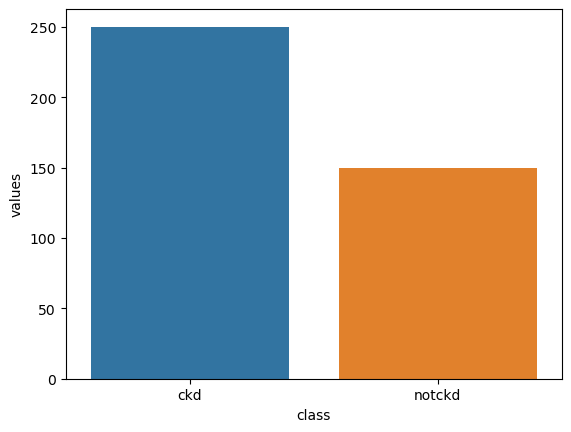

In [12]:
temp=data_kidney["class"].value_counts()
temp_df=pd.DataFrame({'class':temp.index,'values': temp.values})
print(sns.barplot(x='class',y="values",data=temp_df))


# Detecting outliers

In [13]:
import scipy.stats as stats
def diagnostic_plots(df, variable):


    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.distplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('RM quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')

    plt.show()

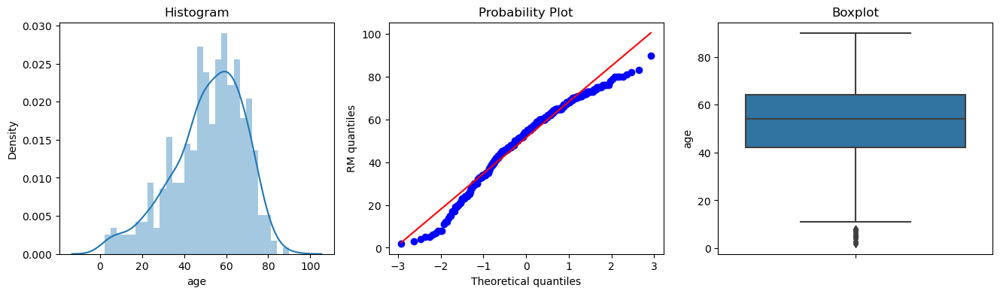

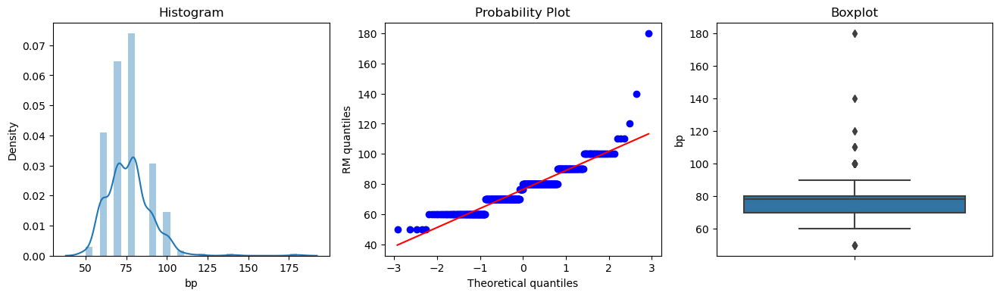

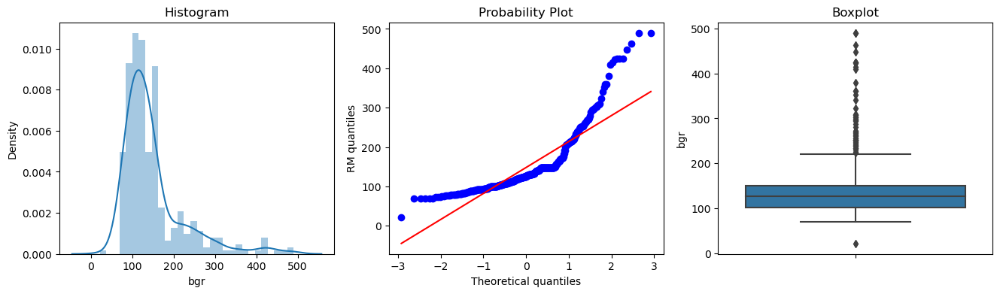

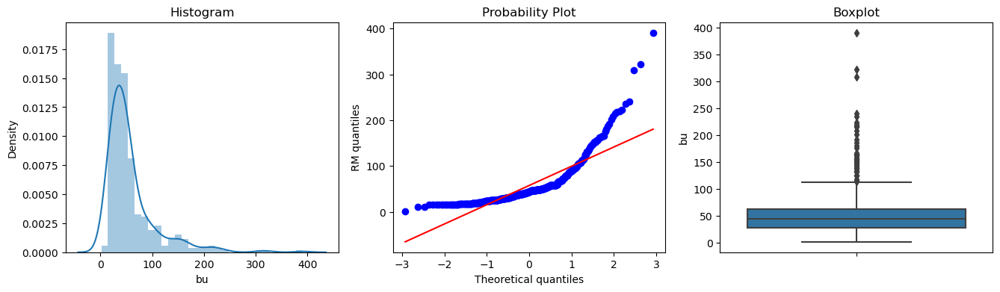

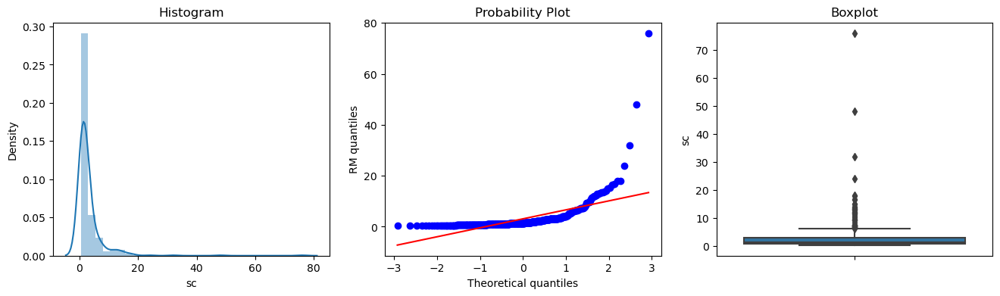

...

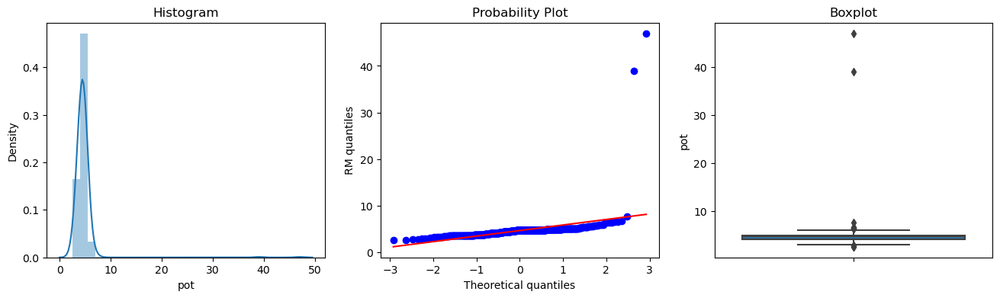

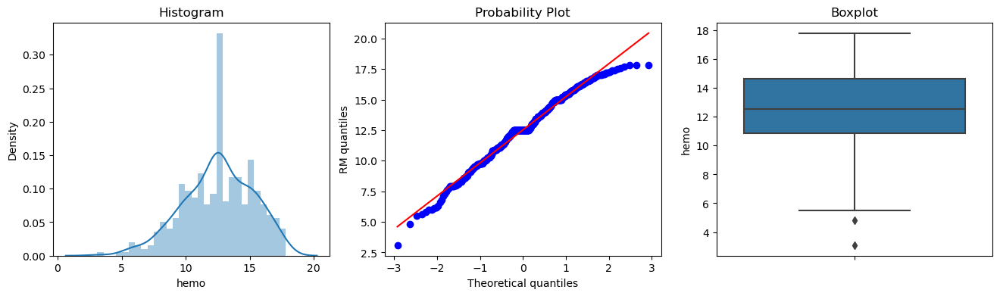

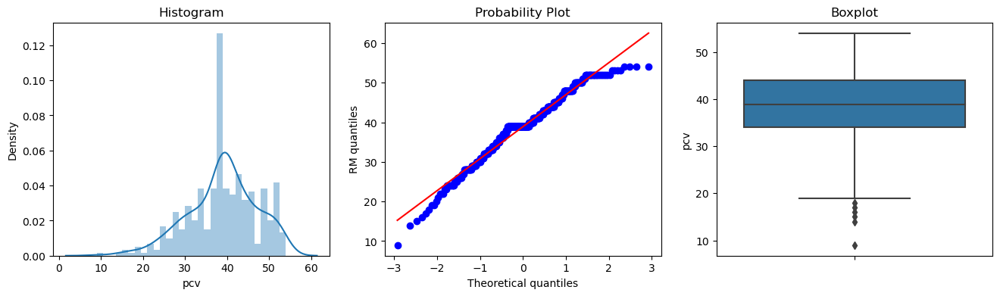

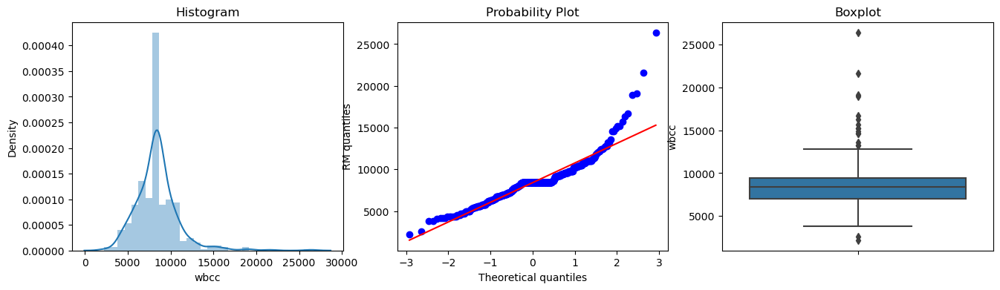

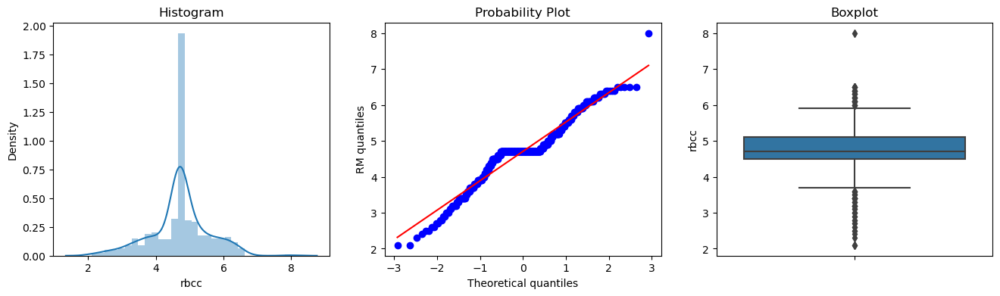

In [14]:
for Columns in ['age','bp','bgr','bu','sc','sod','pot','hemo','pcv','wbcc','rbcc']:
        diagnostic_plots(data_kidney,Columns)

commentaire : on remarque qu il ya feature ont valeur outliets on ne peut supprimer car ces cas sont presetns dans la domaine medicale

# Encoding categorical feature

In [13]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in data_kidney:
    if data_kidney[col].dtype == 'object':
        # If 2 or fewer unique categories
      
            # Train on the training data
            le.fit(data_kidney[col])
            # Transform both training and testing data
            data_kidney[col] = le.transform(data_kidney[col])
            # app_test[col] = le.transform(app_test[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1

In [14]:
data_kidney

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wbcc,rbcc,htn,dm,cad,appet,pe,ane,class
0,48.0,80.0,3,1,0,1,1,0,0,121.000000,...,44.0,7800.0,5.200000,1,1,0,0,0,0,0
1,7.0,50.0,3,4,0,1,1,0,0,148.036517,...,38.0,6000.0,4.707435,0,0,0,0,0,0,0
2,62.0,80.0,1,2,3,1,1,0,0,423.000000,...,31.0,7500.0,4.707435,0,1,0,1,0,1,0
3,48.0,70.0,0,4,0,1,0,1,0,117.000000,...,32.0,6700.0,3.900000,1,0,0,1,1,1,0
4,51.0,80.0,1,2,0,1,1,0,0,106.000000,...,35.0,7300.0,4.600000,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,55.0,80.0,3,0,0,1,1,0,0,140.000000,...,47.0,6700.0,4.900000,0,0,0,0,0,0,1
396,42.0,70.0,4,0,0,1,1,0,0,75.000000,...,54.0,7800.0,6.200000,0,0,0,0,0,0,1
397,12.0,80.0,3,0,0,1,1,0,0,100.000000,...,49.0,6600.0,5.400000,0,0,0,0,0,0,1
398,17.0,60.0,4,0,0,1,1,0,0,114.000000,...,51.0,7200.0,5.900000,0,0,0,0,0,0,1


In [43]:
names = ['age','bp','sg','al', 'su','rbc','pc','pcc','ba','bgr','bu',  
         'sc','sod', 'pot','hemo', 'pcv','wbcc',
         'rbcc','htn','dm','cad','appet','ane','pe']





#scaled_data_kidney[names] = preprocessing.normalize(scaled_data_kidney[names])

###################
scaler = MinMaxScaler()

scaled_data = data_kidney
scaled_data[names] = scaler.fit_transform(scaled_data[names])

#############
#scaled_data_kidney[names] = preprocessing.StandardScaler().fit(scaled_data_kidney[names]).transform(scaled_data_kidney[names])

scaled_data.head()

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wbcc,rbcc,htn,dm,cad,appet,pe,ane,class
0,0.522727,0.230769,0.75,0.2,0.0,1.0,1.0,0.0,0.0,0.211538,...,0.777778,0.231405,0.525424,1.0,1.0,0.0,0.0,0.0,0.0,0
1,0.056818,0.000000,0.75,0.8,0.0,1.0,1.0,0.0,0.0,0.269309,...,0.644444,0.157025,0.441938,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.681818,0.230769,0.25,0.4,0.6,1.0,1.0,0.0,0.0,0.856838,...,0.488889,0.219008,0.441938,0.0,1.0,0.0,1.0,0.0,1.0,0
3,0.522727,0.153846,0.00,0.8,0.0,1.0,0.0,1.0,0.0,0.202991,...,0.511111,0.185950,0.305085,1.0,0.0,0.0,1.0,1.0,1.0,0
4,0.556818,0.230769,0.25,0.4,0.0,1.0,1.0,0.0,0.0,0.179487,...,0.577778,0.210744,0.423729,0.0,0.0,0.0,0.0,0.0,0.0,0


# Feature Selection

# Correlation

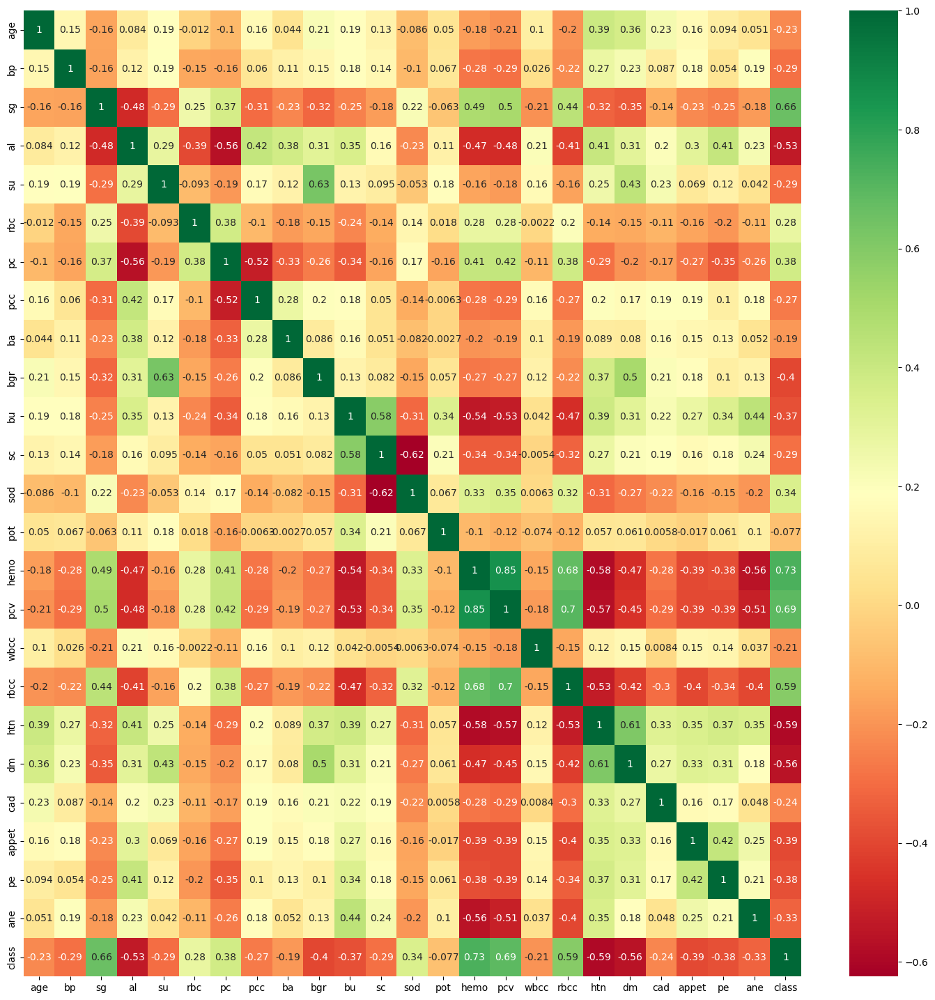

In [18]:
plt.figure(figsize=(18,18))
sns.heatmap(scaled_data.corr(),annot=True,cmap='RdYlGn')

plt.show()

# CFS

In [19]:
features_score = scaled_data.corr()['class'].sort_values()
features_score

htn     -0.590438
dm      -0.559060
al      -0.531562
bgr     -0.401374
appet   -0.393341
pe      -0.375154
bu      -0.372033
ane     -0.325396
su      -0.294555
sc      -0.294079
bp      -0.290600
pcc     -0.265313
cad     -0.236088
age     -0.225405
wbcc    -0.205274
ba      -0.186871
pot     -0.076921
rbc      0.282642
sod      0.342288
pc       0.375154
rbcc     0.590913
sg       0.659504
pcv      0.690060
hemo     0.729628
class    1.000000
Name: class, dtype: float64

<AxesSubplot:>

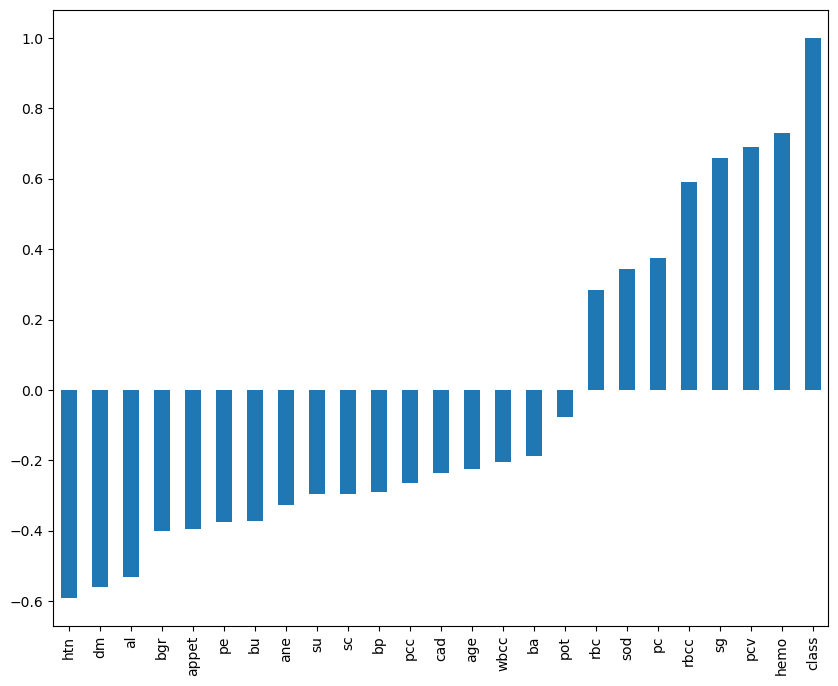

In [21]:
features_score.plot(kind='bar',figsize=(10,8))

In [22]:
data_kidney

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wbcc,rbcc,htn,dm,cad,appet,pe,ane,class
0,48.0,80.0,3,1,0,1,1,0,0,121.000000,...,44.0,7800.0,5.200000,1,1,0,0,0,0,0
1,7.0,50.0,3,4,0,1,1,0,0,148.036517,...,38.0,6000.0,4.707435,0,0,0,0,0,0,0
2,62.0,80.0,1,2,3,1,1,0,0,423.000000,...,31.0,7500.0,4.707435,0,1,0,1,0,1,0
3,48.0,70.0,0,4,0,1,0,1,0,117.000000,...,32.0,6700.0,3.900000,1,0,0,1,1,1,0
4,51.0,80.0,1,2,0,1,1,0,0,106.000000,...,35.0,7300.0,4.600000,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,55.0,80.0,3,0,0,1,1,0,0,140.000000,...,47.0,6700.0,4.900000,0,0,0,0,0,0,1
396,42.0,70.0,4,0,0,1,1,0,0,75.000000,...,54.0,7800.0,6.200000,0,0,0,0,0,0,1
397,12.0,80.0,3,0,0,1,1,0,0,100.000000,...,49.0,6600.0,5.400000,0,0,0,0,0,0,1
398,17.0,60.0,4,0,0,1,1,0,0,114.000000,...,51.0,7200.0,5.900000,0,0,0,0,0,0,1


In [23]:
label = 'class'

# list with feature names (V1, V2, V3, ...)
features = scaled_data.columns.tolist()
features
features.remove(label)


def getMerit(subset, label):
    k = len(subset)

    # average feature-class correlation
    rcf_all = []
    for feature in subset:
        coeff = pointbiserialr( scaled_data[label], scaled_data[feature] )
        rcf_all.append( abs( coeff.correlation ) )
    rcf = np.mean( rcf_all )

    # average feature-feature correlation
    corr = scaled_data[subset].corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    corr = abs(corr)
    rff = corr.unstack().mean()

    return (k * rcf) / sqrt(k + k * (k-1) * rff)


corr = scaled_data.corr()
corr

corr.values[np.tril_indices_from(corr.values)] = np.nan
corr



best_value = -1
best_feature = ''
for feature in features:
    coeff = pointbiserialr( scaled_data[label], scaled_data[feature] )
    abs_coeff = abs( coeff.correlation )
    if abs_coeff > best_value :
        best_value = abs_coeff
        best_feature = feature

print("Feature %s with merit %.4f"%(best_feature, best_value))

Feature hemo with merit 0.7296


In [26]:
class PriorityQueue:
    def  __init__(self):
        self.queue = []

    def isEmpty(self):
        return len(self.queue) == 0
    
    def push(self, item, priority):
        """
        item already in priority queue with smaller priority:
        -> update its priority
        item already in priority queue with higher priority:
        -> do nothing
        if item not in priority queue:
        -> push it
        """
        for index, (i, p) in enumerate(self.queue):
            if (set(i) == set(item)):
                if (p >= priority):
                    break
                del self.queue[index]
                self.queue.append( (item, priority) )
                break
        else:
            self.queue.append( (item, priority) )
        
    def pop(self):
        # return item with highest priority and remove it from queue
        max_idx = 0
        for index, (i, p) in enumerate(self.queue):
            if (self.queue[max_idx][1] < p):
                max_idx = index
        (item, priority) = self.queue[max_idx]
        del self.queue[max_idx]
        return (item, priority)
    
    
# initialize queue
queue = PriorityQueue()

# push first tuple (subset, merit)
queue.push([best_feature], best_value)




In [27]:
# list for visited nodes
visited = []

# counter for backtracks
n_backtrack = 0

# limit of backtracks
max_backtrack = 17

In [28]:
while not queue.isEmpty():
    # get element of queue with highest merit
    subset, priority = queue.pop()
    
    # check whether the priority of this subset
    # is higher than the current best subset
    if (priority < best_value):
        n_backtrack += 1
    else:
        best_value = priority
        best_subset = subset

    # goal condition
    if (n_backtrack == max_backtrack):
        break
    
    # iterate through all features and look of one can
    # increase the merit
    for feature in features:
        temp_subset = subset + [feature]
        
        # check if this subset has already been evaluated
        for node in visited:
            if (set(node) == set(temp_subset)):
                break
        # if not, ...
        else:
            # ... mark it as visited
            visited.append( temp_subset )
            # ... compute merit
            merit = getMerit(temp_subset, label)
            # and push it to the queue
            queue.push(temp_subset, merit)

# Splitting the data into training and test sets

In [15]:
X = data_kidney.iloc[:,:-1].values
y = data_kidney.iloc[:,-1].values

#X = data_kidney.drop(columns=['class'],axis=1)
#y = data_kidney['class']

In [16]:
X

array([[48., 80.,  3., ...,  0.,  0.,  0.],
       [ 7., 50.,  3., ...,  0.,  0.,  0.],
       [62., 80.,  1., ...,  1.,  0.,  1.],
       ...,
       [12., 80.,  3., ...,  0.,  0.,  0.],
       [17., 60.,  4., ...,  0.,  0.,  0.],
       [58., 80.,  4., ...,  0.,  0.,  0.]])

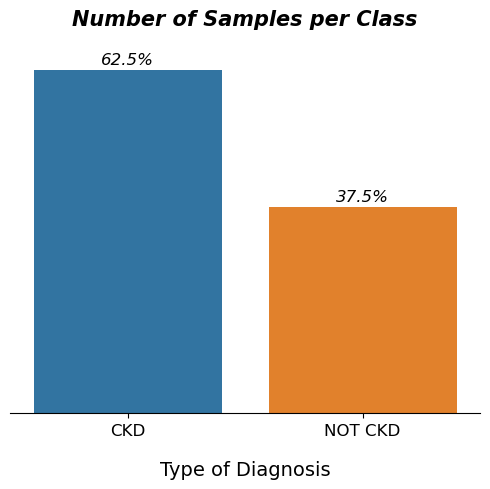

In [17]:
plt.figure(figsize=(5, 5))

sns.countplot(data = data_kidney , x = 'class' , order = data_kidney['class'].value_counts().index)
sns.despine(top=True, right=True, left=True, bottom=False)

plt.xticks(ticks= [0,1], labels=['CKD', 'NOT CKD'], fontsize=12)
plt.yticks([])
plt.title('Number of Samples per Class' , fontsize=15 , pad=20 , fontstyle='italic' , fontweight = 800)
plt.xlabel('Type of Diagnosis' , fontsize=14 , fontweight=400, labelpad=16)
plt.ylabel('')
ax = plt.gca()

for p in ax.patches:
    ax.annotate("%.1f%%" % (100*float(p.get_height()/data_kidney.shape[0])), (p.get_x() + p.get_width() / 2., abs(p.get_height())), ha='center', 
                va='bottom', color='black', xytext=(0,2), rotation='horizontal', textcoords='offset points', fontsize = 12, fontstyle = 'italic')

# plt.savefig("samples.png")
plt.tight_layout()

In [18]:

scaler = MinMaxScaler()
X = scaler.fit_transform(X)
#X = preprocessing.StandardScaler().fit(X).transform(X)
#X = preprocessing.normalize(X)

features = ['age','bp','sg','al', 'su','rbc','pc','pcc','ba','bgr','bu',  
         'sc','sod', 'pot','hemo', 'pcv','wbcc',
         'rbcc','htn','dm','cad','appet','ane','pe']

#X[features] = scaler.fit_transform(X[features])




In [19]:
X

array([[0.52272727, 0.23076923, 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [0.05681818, 0.        , 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [0.68181818, 0.23076923, 0.25      , ..., 1.        , 0.        ,
        1.        ],
       ...,
       [0.11363636, 0.23076923, 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [0.17045455, 0.07692308, 1.        , ..., 0.        , 0.        ,
        0.        ],
       [0.63636364, 0.23076923, 1.        , ..., 0.        , 0.        ,
        0.        ]])

# Train Test

In [20]:


X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.3, random_state = 0, stratify=y)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (280, 24) (280,)
Test set: (120, 24) (120,)


# Classifier

# KNN

Now we are going to use KNN Classifier

In [21]:
knn = KNeighborsClassifier()

### Method 1

In [22]:
param_grid = {"n_neighbors": np.arange(1, 25)}

knn_gscv = GridSearchCV(knn, param_grid, cv=5)
knn_gscv.fit(X, y)


GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24])})

In [23]:
print(knn_gscv.best_params_)
print(knn_gscv.best_score_)

{'n_neighbors': 2}
0.99


### Method 2

In [24]:
Ks = 10
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))

for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.98333333, 0.99166667, 0.95833333, 0.95833333, 0.95      ,
       0.95833333, 0.94166667, 0.95833333, 0.94166667])

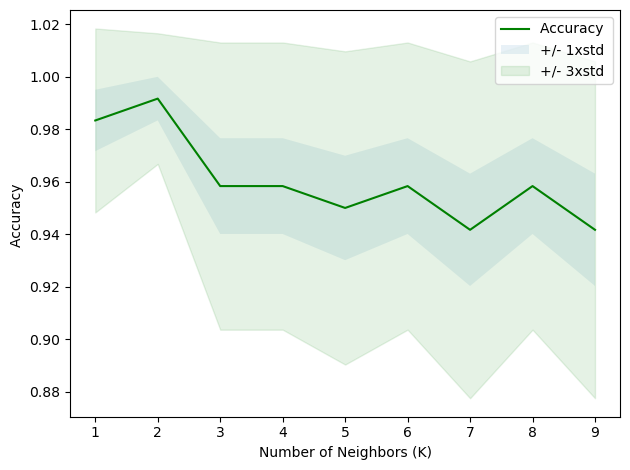

In [25]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.fill_between(range(1,Ks),mean_acc - 3 * std_acc,mean_acc + 3 * std_acc, alpha=0.10,color="green")
plt.legend(('Accuracy ', '+/- 1xstd','+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbors (K)')
plt.tight_layout()
plt.show()

In [26]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

The best accuracy was with 0.9916666666666667 with k= 2


We will use the parametre K=2 for KNN modeling

### Model fit


In [27]:
classes = ['CKD','NCKD']

              precision    recall  f1-score   support

           0       1.00      0.92      0.96        75
           1       0.88      1.00      0.94        45

    accuracy                           0.95       120
   macro avg       0.94      0.96      0.95       120
weighted avg       0.96      0.95      0.95       120

----------------- Overall Results -----------------
Accuracy Result: 95.00%
Precision Result: 94.12%
Recall Result: 96.00%
F1-Score Result: 94.79%


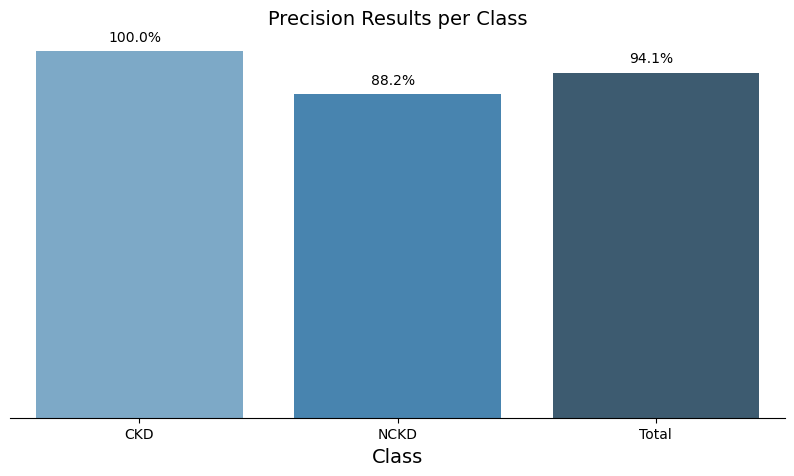

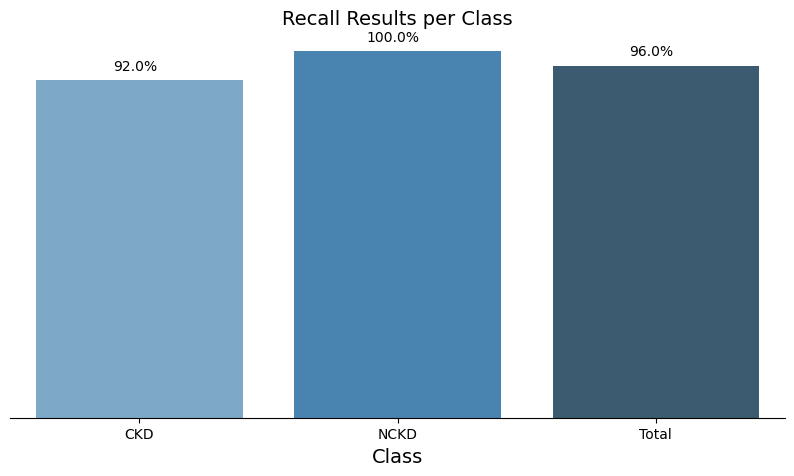

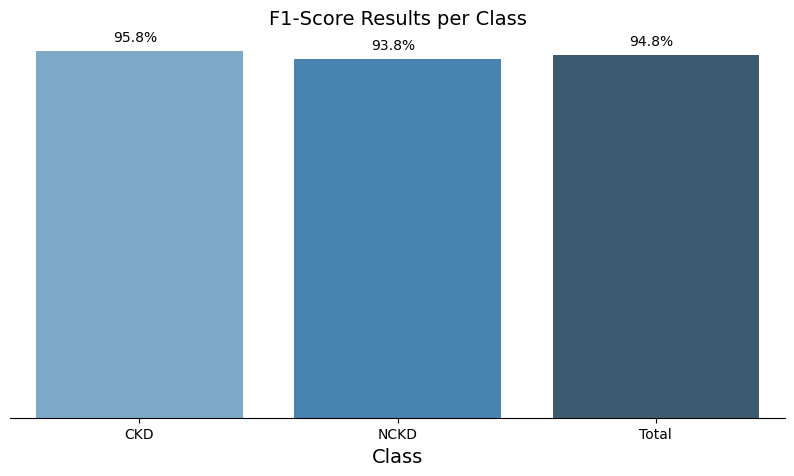

In [28]:
knn.fit(X_train, y_train)

# prediction
preds = knn.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

def metrics_plot(df,metric):
    plt.figure(figsize=(10, 5))
    ax = sns.barplot(data=df, x=df.index, y=metric, palette = "Blues_d")
    # Bar Labels
    for p in ax.patches:
        ax.annotate("%.1f%%" % (100*p.get_height()), (p.get_x() + p.get_width() / 2., abs(p.get_height())),
        ha='center', va='bottom', color='black', xytext=(-3, 5),rotation = 'horizontal',textcoords='offset points')
    sns.despine(top=True, right=True, left=True, bottom=False)
    ax.set_xlabel('Class',fontsize = 14)
    ax.set_ylabel(metric,fontsize = 14)
    ax.set(yticklabels=[])
    ax.axes.get_yaxis().set_visible(False) 
    plt.title(metric+ ' Results per Class', fontsize = 14);

metrics_plot(all_df, 'Precision')       # Results by Class
metrics_plot(all_df, 'Recall')          # Results by Class
metrics_plot(all_df, 'F1-Score')         # Results by Class
print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

In [29]:
train_score= knn.score(X_train,y_train)
test_score = knn.score(X_test,y_test)

print('train score=', train_score )
print('test score=', test_score)

train score= 0.9892857142857143
test score= 0.95


# Confusion matrix visualization

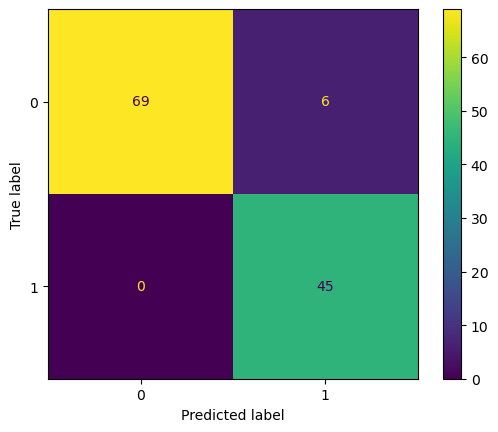

In [30]:
#  Confusion Matrix
cm1 = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,display_labels=knn.classes_)
disp.plot()
plt.show()

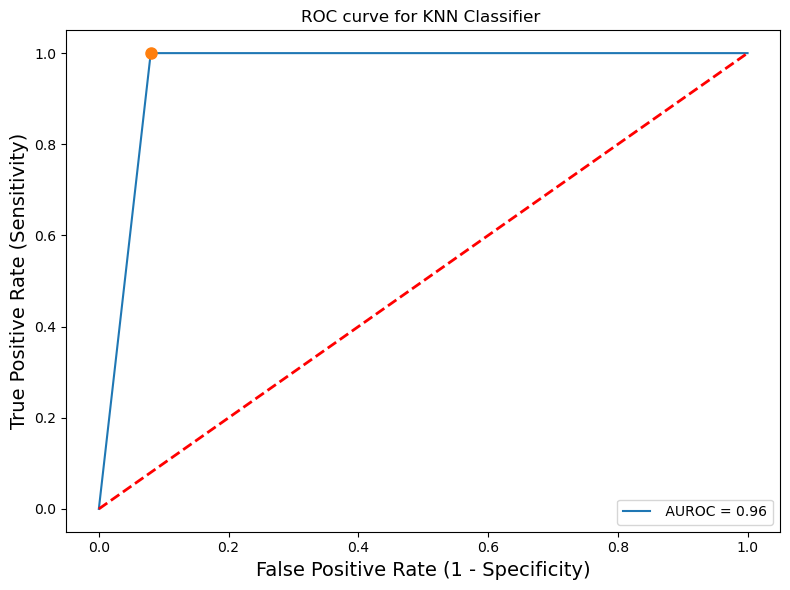

In [31]:
fig, (ax2) = plt.subplots(figsize = (8,6))
        #roc-curve
fpr, tpr, thresholds_roc = roc_curve(y_test,preds)
roc_auc = auc(fpr,tpr)
ax2.plot(fpr,tpr, label = " AUROC = {:0.2f}".format(roc_auc))
ax2.plot([0,1], [0,1], 'r', linestyle = "--", lw = 2)
ax2.set_xlabel("False Positive Rate", fontsize = 14)
ax2.set_ylabel("True Positive Rate", fontsize = 14)
ax2.set_title("ROC Curve", fontsize = 18)
ax2.legend(loc = 'best')
plt.title('ROC curve for KNN Classifier ')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
        #find default threshold
close_default = np.argmin(np.abs(thresholds_roc - 0.5))
ax2.plot(fpr[close_default], tpr[close_default], 'o', markersize = 8)
plt.tight_layout()

In [32]:
ROC_AUC = roc_auc_score(y_test, preds)

print('ROC AUC : {:.4f}'.format(ROC_AUC))


ROC AUC : 0.9600


the more its close to 1 the better the classifier

# Naive Bayes

## Model fit

In [33]:
GNB = GaussianNB()


In [34]:
# Applying 10-Fold Cross Validation


scores = cross_val_score(GNB, X_train, y_train, cv = 10, scoring='accuracy')

print('Cross-validation scores:{}'.format(scores))

Cross-validation scores:[0.92857143 1.         1.         0.92857143 1.         0.92857143
 0.96428571 0.96428571 1.         0.96428571]


In [35]:
# compute Average cross-validation score
# test 0.958
print('Average cross-validation score: {:.4f}'.format(scores.mean()))

Average cross-validation score: 0.9679


              precision    recall  f1-score   support

           0       1.00      0.93      0.97        75
           1       0.90      1.00      0.95        45

    accuracy                           0.96       120
   macro avg       0.95      0.97      0.96       120
weighted avg       0.96      0.96      0.96       120

----------------- Overall Results -----------------
Accuracy Result: 95.83%
Precision Result: 95.00%
Recall Result: 96.67%
F1-Score Result: 95.64%


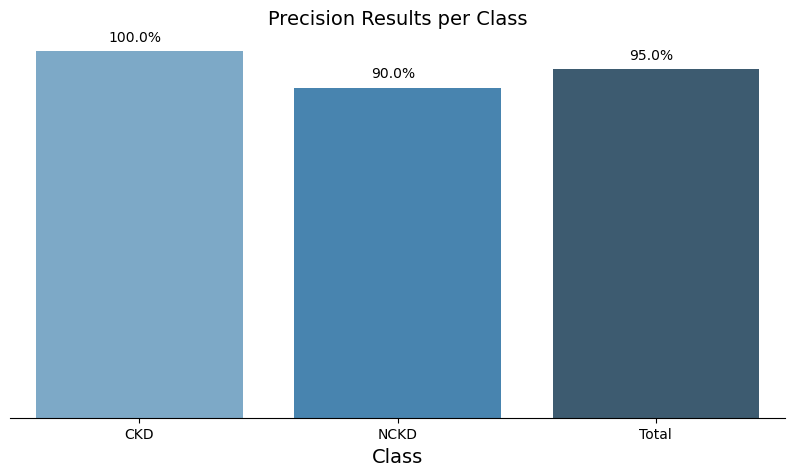

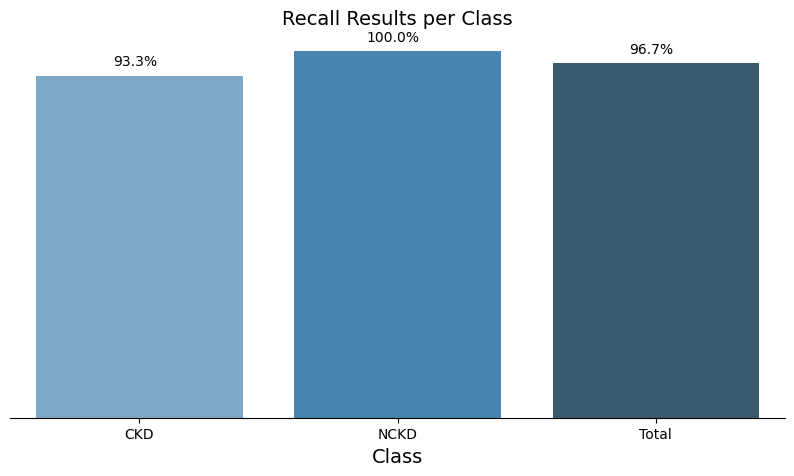

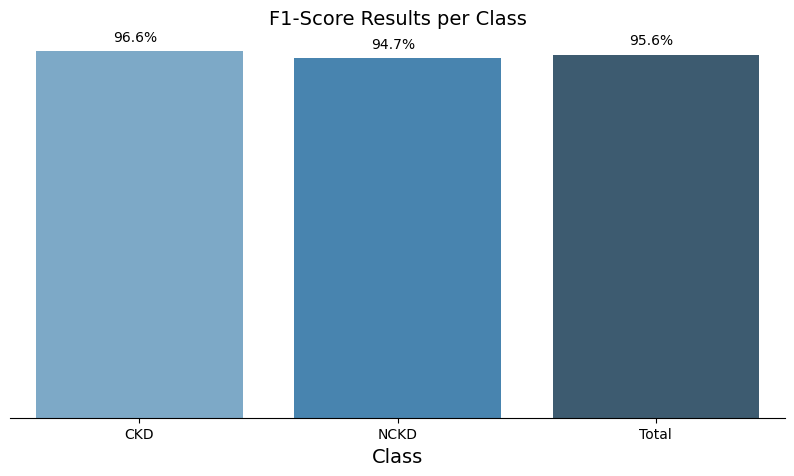

In [36]:
GNB.fit(X_train, y_train)

# prediction
preds = GNB.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

def metrics_plot(df,metric):
    plt.figure(figsize=(10, 5))
    ax = sns.barplot(data=df, x=df.index, y=metric, palette = "Blues_d")
    # Bar Labels
    for p in ax.patches:
        ax.annotate("%.1f%%" % (100*p.get_height()), (p.get_x() + p.get_width() / 2., abs(p.get_height())),
        ha='center', va='bottom', color='black', xytext=(-3, 5),rotation = 'horizontal',textcoords='offset points')
    sns.despine(top=True, right=True, left=True, bottom=False)
    ax.set_xlabel('Class',fontsize = 14)
    ax.set_ylabel(metric,fontsize = 14)
    ax.set(yticklabels=[])
    ax.axes.get_yaxis().set_visible(False) 
    plt.title(metric+ ' Results per Class', fontsize = 14);

metrics_plot(all_df, 'Precision')       # Results by Class
metrics_plot(all_df, 'Recall')          # Results by Class
metrics_plot(all_df, 'F1-Score')         # Results by Class
print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

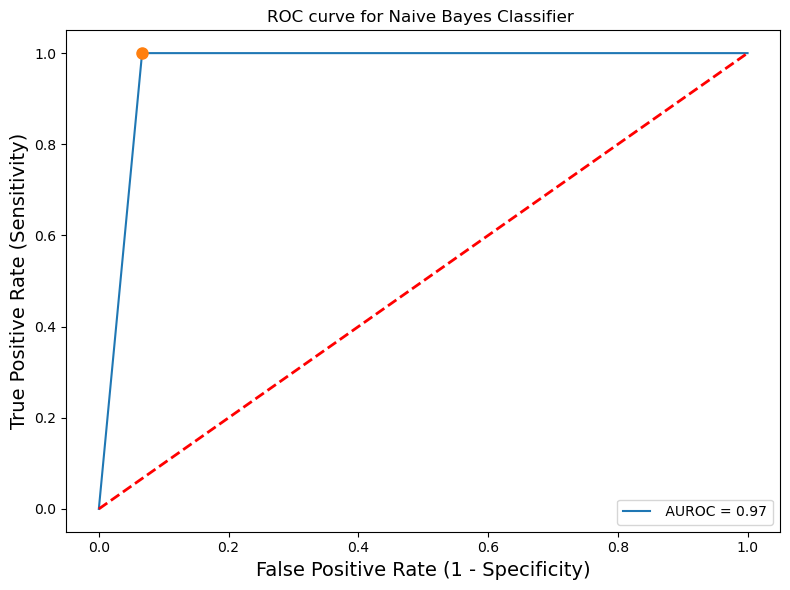

In [37]:
fig, (ax2) = plt.subplots(figsize = (8,6))
        #roc-curve
fpr, tpr, thresholds_roc = roc_curve(y_test,preds)
roc_auc = auc(fpr,tpr)
ax2.plot(fpr,tpr, label = " AUROC = {:0.2f}".format(roc_auc))
ax2.plot([0,1], [0,1], 'r', linestyle = "--", lw = 2)
ax2.set_xlabel("False Positive Rate", fontsize = 14)
ax2.set_ylabel("True Positive Rate", fontsize = 14)
ax2.set_title("ROC Curve", fontsize = 18)
ax2.legend(loc = 'best')
plt.title('ROC curve for Naive Bayes Classifier ')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
        #find default threshold
close_default = np.argmin(np.abs(thresholds_roc - 0.5))
ax2.plot(fpr[close_default], tpr[close_default], 'o', markersize = 8)
plt.tight_layout()

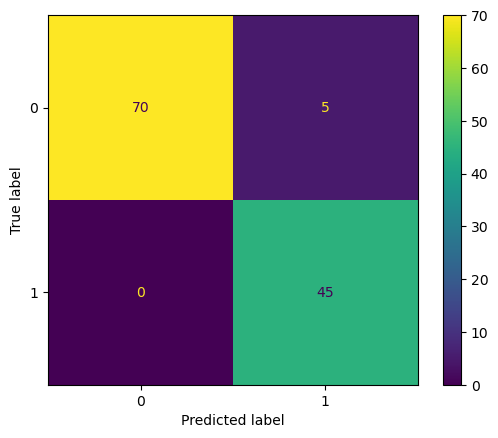

In [38]:
#  Confusion Matrix
cm1 = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,display_labels=GNB.classes_)
disp.plot()
plt.show()

# SVM

              precision    recall  f1-score   support

           0       1.00      0.93      0.97        75
           1       0.90      1.00      0.95        45

    accuracy                           0.96       120
   macro avg       0.95      0.97      0.96       120
weighted avg       0.96      0.96      0.96       120

----------------- Overall Results -----------------
Accuracy Result: 95.83%
Precision Result: 95.00%
Recall Result: 96.67%
F1-Score Result: 95.64%


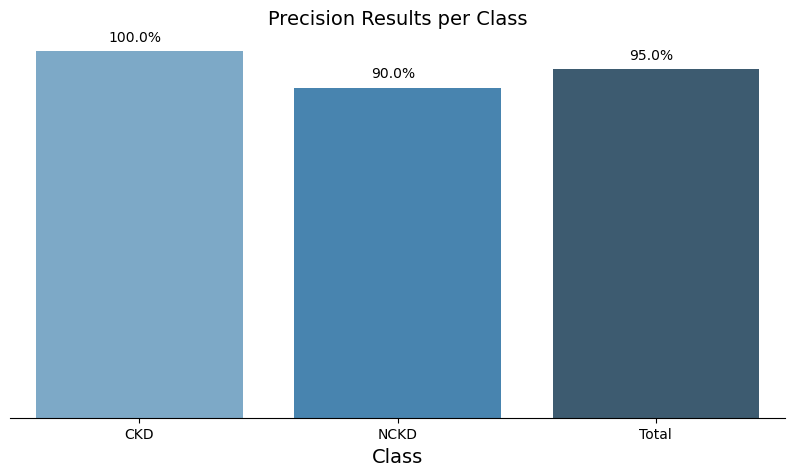

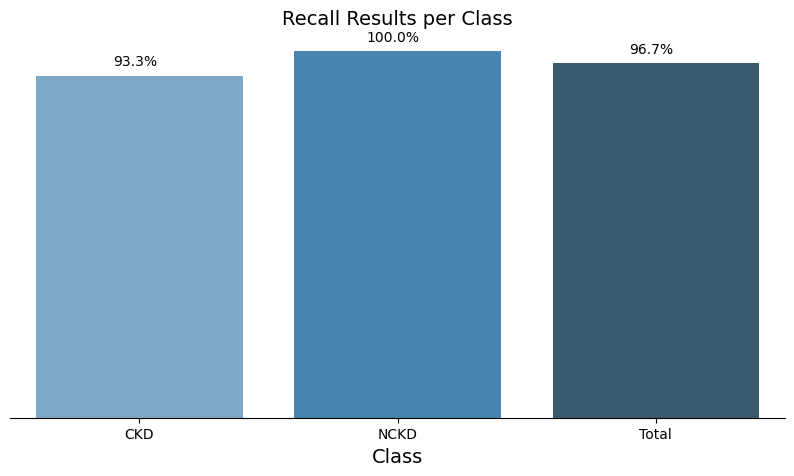

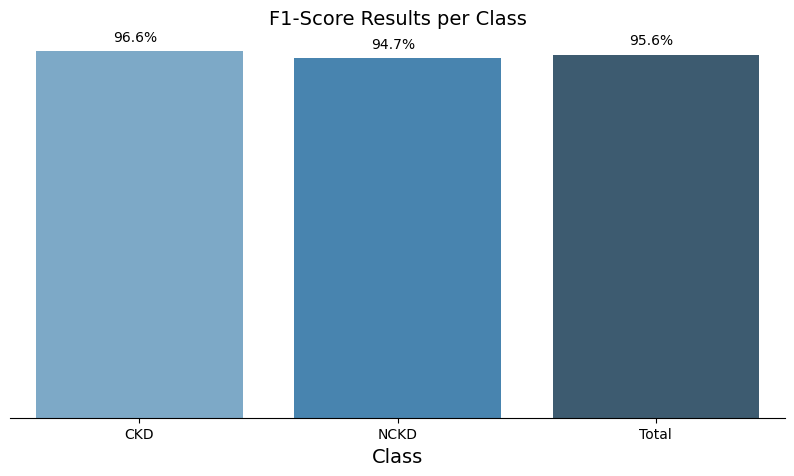

In [39]:
# model fit
M_SVM = svm.SVC(kernel='linear')
M_SVM.fit(X_train, y_train)

# prediction
preds = M_SVM.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

def metrics_plot(df,metric):
    plt.figure(figsize=(10, 5))
    ax = sns.barplot(data=df, x=df.index, y=metric, palette = "Blues_d")
    # Bar Labels
    for p in ax.patches:
        ax.annotate("%.1f%%" % (100*p.get_height()), (p.get_x() + p.get_width() / 2., abs(p.get_height())),
        ha='center', va='bottom', color='black', xytext=(-3, 5),rotation = 'horizontal',textcoords='offset points')
    sns.despine(top=True, right=True, left=True, bottom=False)
    ax.set_xlabel('Class',fontsize = 14)
    ax.set_ylabel(metric,fontsize = 14)
    ax.set(yticklabels=[])
    ax.axes.get_yaxis().set_visible(False) 
    plt.title(metric+ ' Results per Class', fontsize = 14);

metrics_plot(all_df, 'Precision')       # Results by Class
metrics_plot(all_df, 'Recall')          # Results by Class
metrics_plot(all_df, 'F1-Score')         # Results by Class
print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

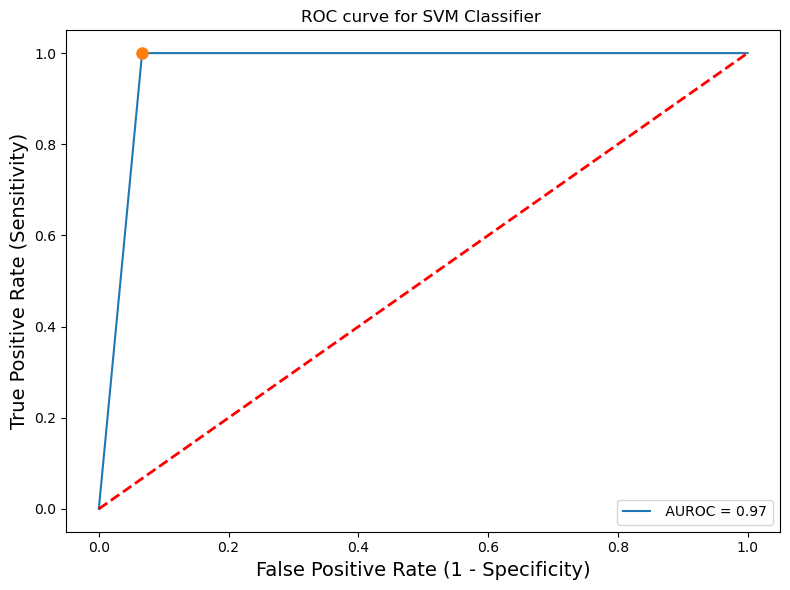

In [40]:
fig, (ax2) = plt.subplots(figsize = (8,6))
        #roc-curve
fpr, tpr, thresholds_roc = roc_curve(y_test,preds)
roc_auc = auc(fpr,tpr)
ax2.plot(fpr,tpr, label = " AUROC = {:0.2f}".format(roc_auc))
ax2.plot([0,1], [0,1], 'r', linestyle = "--", lw = 2)
ax2.set_xlabel("False Positive Rate", fontsize = 14)
ax2.set_ylabel("True Positive Rate", fontsize = 14)
ax2.set_title("ROC Curve", fontsize = 18)
ax2.legend(loc = 'best')
plt.title('ROC curve for SVM Classifier ')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
        #find default threshold
close_default = np.argmin(np.abs(thresholds_roc - 0.5))
ax2.plot(fpr[close_default], tpr[close_default], 'o', markersize = 8)
plt.tight_layout()

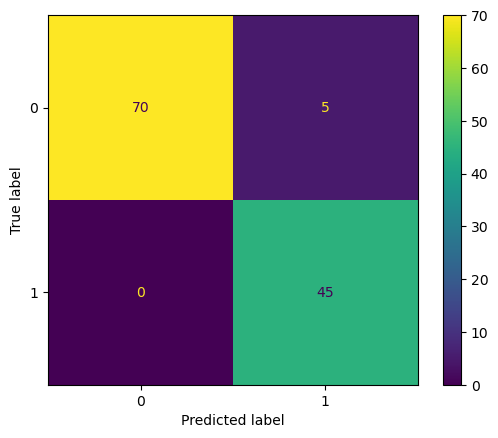

In [41]:
#  Confusion Matrix
cm1 = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,display_labels=M_SVM.classes_)
disp.plot()
plt.show()

# Logistic Regression

              precision    recall  f1-score   support

           0       1.00      0.91      0.95        75
           1       0.87      1.00      0.93        45

    accuracy                           0.94       120
   macro avg       0.93      0.95      0.94       120
weighted avg       0.95      0.94      0.94       120

----------------- Overall Results -----------------
Accuracy Result: 94.17%
Precision Result: 93.27%
Recall Result: 95.33%
F1-Score Result: 93.94%


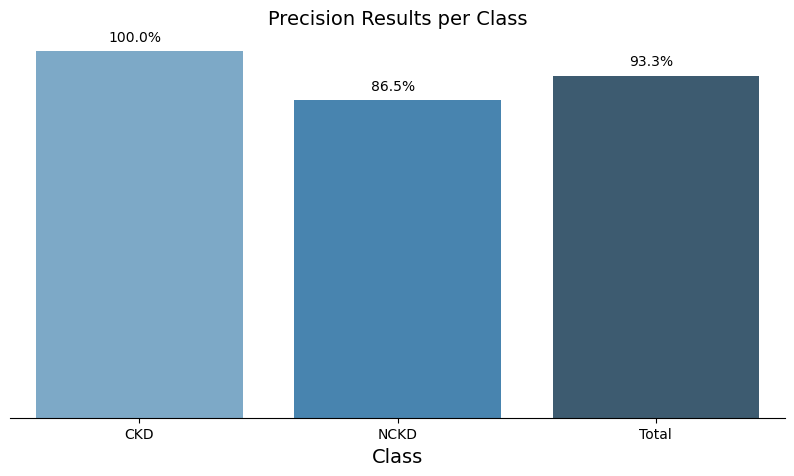

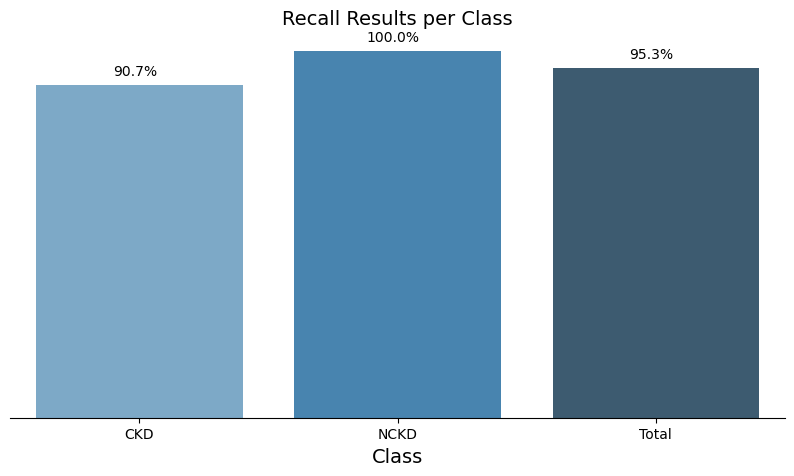

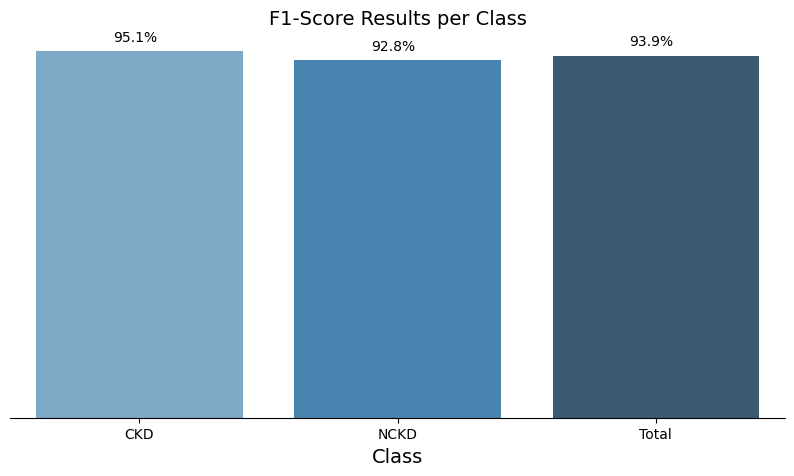

In [42]:
# model fit
LR = LogisticRegression()
LR.fit(X_train, y_train)

# prediction
preds = LR.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

def metrics_plot(df,metric):
    plt.figure(figsize=(10, 5))
    ax = sns.barplot(data=df, x=df.index, y=metric, palette = "Blues_d")
    # Bar Labels
    for p in ax.patches:
        ax.annotate("%.1f%%" % (100*p.get_height()), (p.get_x() + p.get_width() / 2., abs(p.get_height())),
        ha='center', va='bottom', color='black', xytext=(-3, 5),rotation = 'horizontal',textcoords='offset points')
    sns.despine(top=True, right=True, left=True, bottom=False)
    ax.set_xlabel('Class',fontsize = 14)
    ax.set_ylabel(metric,fontsize = 14)
    ax.set(yticklabels=[])
    ax.axes.get_yaxis().set_visible(False) 
    plt.title(metric+ ' Results per Class', fontsize = 14);

metrics_plot(all_df, 'Precision')       # Results by Class
metrics_plot(all_df, 'Recall')          # Results by Class
metrics_plot(all_df, 'F1-Score')         # Results by Class
print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

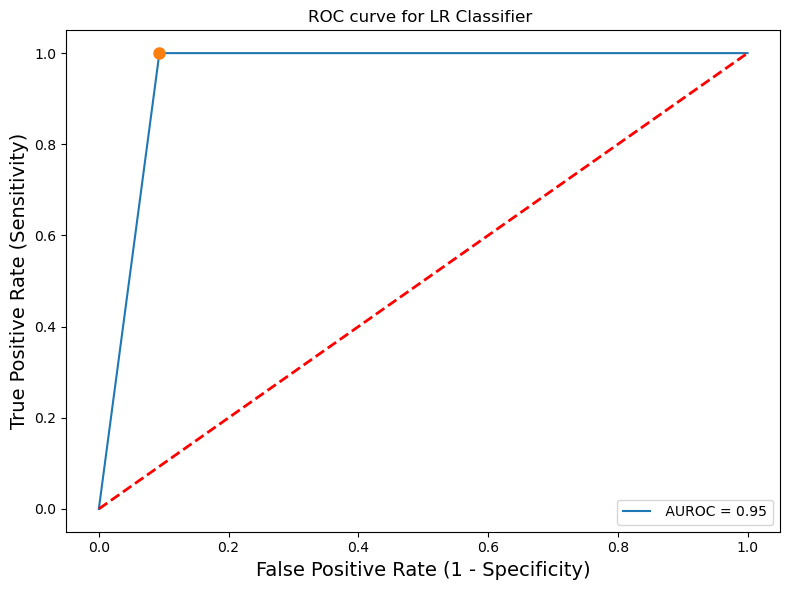

In [43]:
fig, (ax2) = plt.subplots(figsize = (8,6))
        #roc-curve
fpr, tpr, thresholds_roc = roc_curve(y_test,preds)
roc_auc = auc(fpr,tpr)
ax2.plot(fpr,tpr, label = " AUROC = {:0.2f}".format(roc_auc))
ax2.plot([0,1], [0,1], 'r', linestyle = "--", lw = 2)
ax2.set_xlabel("False Positive Rate", fontsize = 14)
ax2.set_ylabel("True Positive Rate", fontsize = 14)
ax2.set_title("ROC Curve", fontsize = 18)
ax2.legend(loc = 'best')
plt.title('ROC curve for LR Classifier ')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
        #find default threshold
close_default = np.argmin(np.abs(thresholds_roc - 0.5))
ax2.plot(fpr[close_default], tpr[close_default], 'o', markersize = 8)
plt.tight_layout()

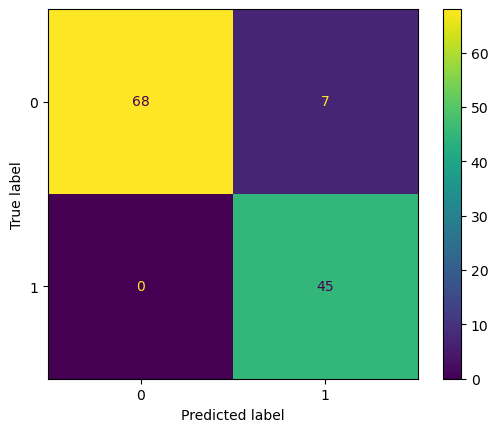

In [44]:
#  Confusion Matrix
cm1 = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,display_labels=LR.classes_)
disp.plot()
plt.show()

# Adaboost

              precision    recall  f1-score   support

           0       1.00      0.99      0.99        75
           1       0.98      1.00      0.99        45

    accuracy                           0.99       120
   macro avg       0.99      0.99      0.99       120
weighted avg       0.99      0.99      0.99       120

----------------- Overall Results -----------------
Accuracy Result: 99.17%
Precision Result: 98.91%
Recall Result: 99.33%
F1-Score Result: 99.11%


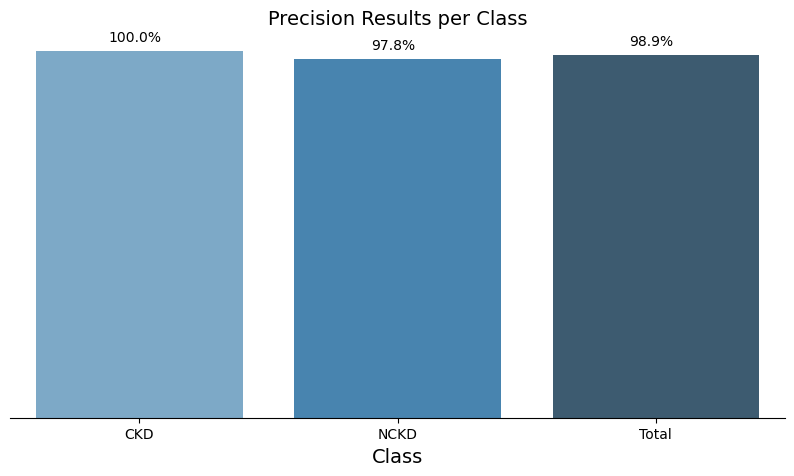

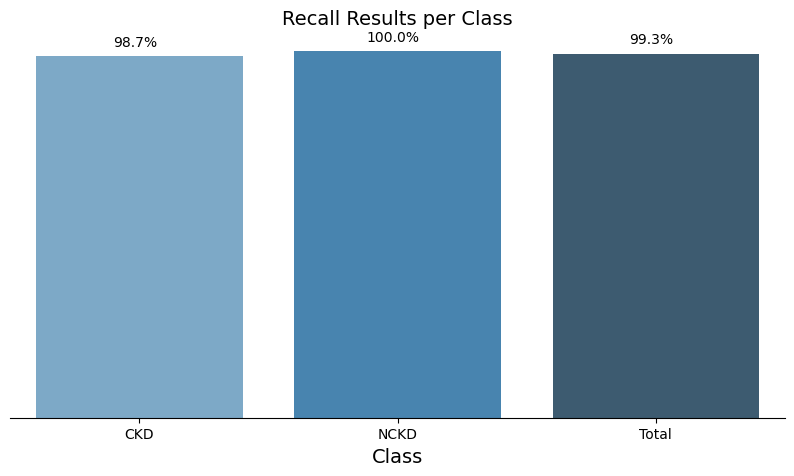

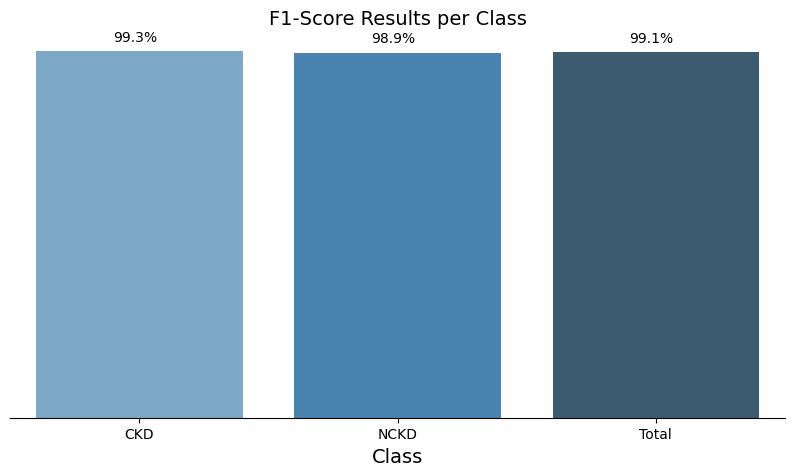

In [45]:
# model fit
Ada = AdaBoostClassifier()
Ada.fit(X_train, y_train,sample_weight=None)

# prediction
preds = Ada.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

def metrics_plot(df,metric):
    plt.figure(figsize=(10, 5))
    ax = sns.barplot(data=df, x=df.index, y=metric, palette = "Blues_d")
    # Bar Labels
    for p in ax.patches:
        ax.annotate("%.1f%%" % (100*p.get_height()), (p.get_x() + p.get_width() / 2., abs(p.get_height())),
        ha='center', va='bottom', color='black', xytext=(-3, 5),rotation = 'horizontal',textcoords='offset points')
    sns.despine(top=True, right=True, left=True, bottom=False)
    ax.set_xlabel('Class',fontsize = 14)
    ax.set_ylabel(metric,fontsize = 14)
    ax.set(yticklabels=[])
    ax.axes.get_yaxis().set_visible(False) 
    plt.title(metric+ ' Results per Class', fontsize = 14);

metrics_plot(all_df, 'Precision')       # Results by Class
metrics_plot(all_df, 'Recall')          # Results by Class
metrics_plot(all_df, 'F1-Score')         # Results by Class
print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

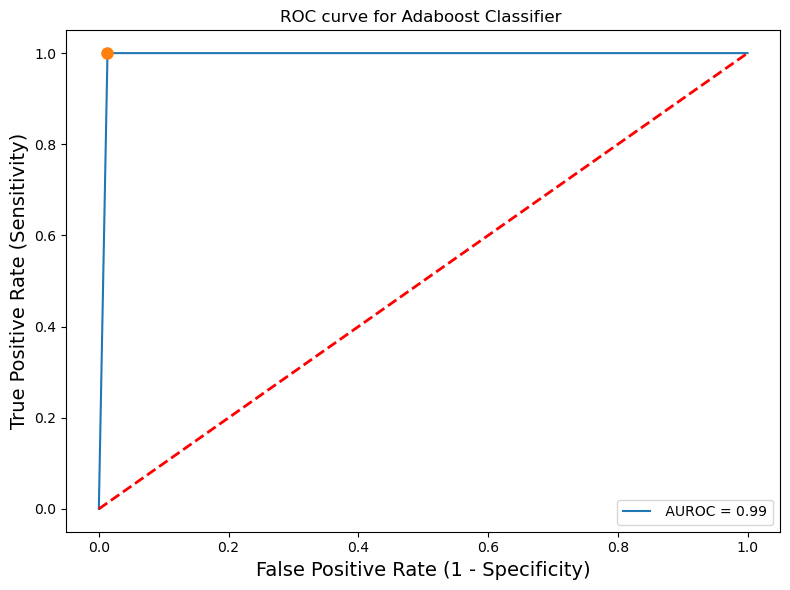

In [46]:
fig, (ax2) = plt.subplots(figsize = (8,6))
        #roc-curve
fpr, tpr, thresholds_roc = roc_curve(y_test,preds)
roc_auc = auc(fpr,tpr)
ax2.plot(fpr,tpr, label = " AUROC = {:0.2f}".format(roc_auc))
ax2.plot([0,1], [0,1], 'r', linestyle = "--", lw = 2)
ax2.set_xlabel("False Positive Rate", fontsize = 14)
ax2.set_ylabel("True Positive Rate", fontsize = 14)
ax2.set_title("ROC Curve", fontsize = 18)
ax2.legend(loc = 'best')
plt.title('ROC curve for Adaboost Classifier ')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
        #find default threshold
close_default = np.argmin(np.abs(thresholds_roc - 0.5))
ax2.plot(fpr[close_default], tpr[close_default], 'o', markersize = 8)
plt.tight_layout()

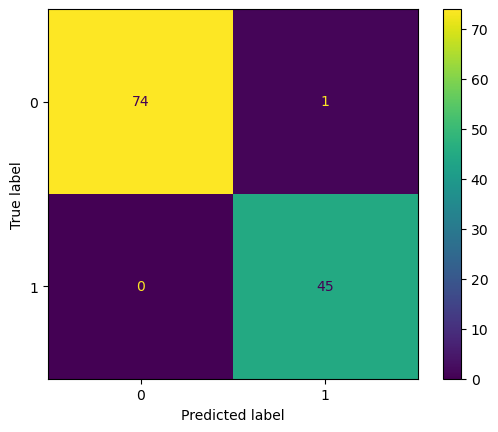

In [47]:
#  Confusion Matrix
cm1 = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,display_labels=Ada.classes_)
disp.plot()
plt.show()

# Comparing the performance of the models

# Train score and Test Score for each model

In [48]:
# Compare Algorithms

models = []
models.append(('Ada Boost', Ada, X_train, y_train, X_test, y_test))
models.append(('Logistic Regression', LR, X_train, y_train, X_test, y_test))
models.append(('KNN', knn,X_train, y_train, X_test, y_test ))
models.append(('Gaussian NB', GNB, X_train, y_train, X_test, y_test))
models.append(('SVM', M_SVM, X_train, y_train, X_test, y_test))

# evaluate each model in turn
train_scores = []
test_scores = []
names = []

ypreds = []
f1_scores = []
aucs = []
precisions = []
recalls = []
scoring = 'accuracy'
for name, mod, x_train, y_train, x_test, y_test in models:
    ypred=mod.predict(x_test)
    ypreds.append(ypred)
    precisions.append(precision_score(y_test, ypred))
    recalls.append(recall_score(y_test, ypred))
    f1_scores.append(f1_score(ypred, y_test))
    test_scores.append(mod.score(x_test,y_test))
    train_scores.append(mod.score(x_train,y_train))
    names.append(name)

In [49]:
train_df= pd.DataFrame({'Algorithms':names, 'Train Score':train_scores, 'Test Score':test_scores, 'Recall':recalls,
                        'Precision':precisions,'F1_score':f1_scores})
train_df

,Algorithms,Train Score,Test Score,Recall,Precision,F1_score
0,Ada Boost,1.000000,0.991667,1.0,0.978261,0.989011
1,Logistic Regression,0.989286,0.941667,1.0,0.865385,0.927835
2,KNN,0.989286,0.950000,1.0,0.882353,0.937500
3,Gaussian NB,0.967857,0.958333,1.0,0.900000,0.947368
4,SVM,0.992857,0.958333,1.0,0.900000,0.947368


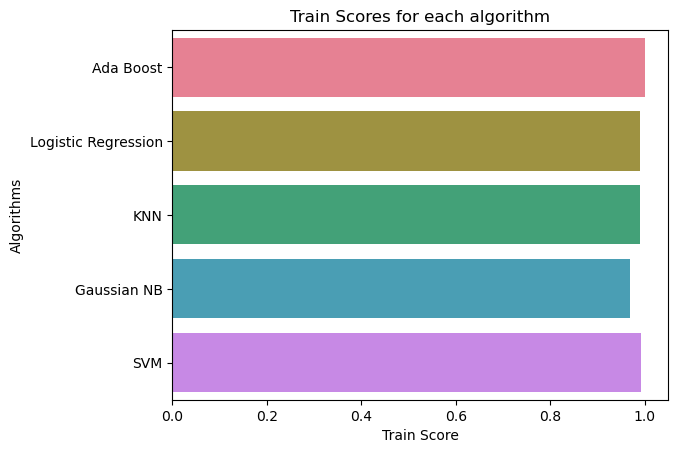

In [50]:
plot = sns.barplot(data = train_df,x="Train Score",y="Algorithms", 
                palette="husl", orient = "h")

plot.set_xlabel("Train Score")
plot = plot.set_title("Train Scores for each algorithm")

# K-fold

In [51]:
# Cross validate model with Kfold stratified cross val
kfold = StratifiedKFold(n_splits=5)

# Modeling step Test differents algorithms 
random_state = 0
classifiers = []

classifiers.append(KNeighborsClassifier())
classifiers.append(GaussianNB())
classifiers.append(LogisticRegression())
classifiers.append(SVC())
classifiers.append(AdaBoostClassifier())


## Accuracy

In [52]:
cv_results = []
for classifier in classifiers :
    cv_results.append(cross_val_score(classifier, X_train, y = y_train, scoring = "accuracy", cv = kfold, n_jobs=-1))

cv_means = []
cv_std = []
for cv_result in cv_results:
    cv_means.append(cv_result.mean())
    cv_std.append(cv_result.std())

cv_res = pd.DataFrame({"CrossValMeans":cv_means,"CrossValerrors": cv_std,"Algorithm":["LR","KNN","SVC","GNB","AdaBoost"]})

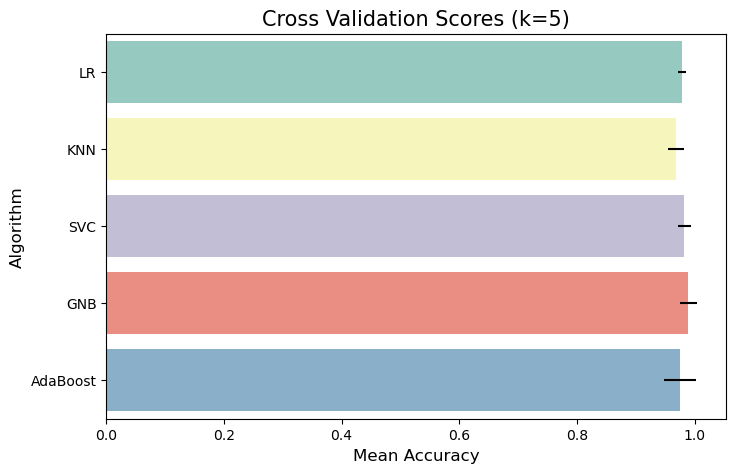

In [53]:
plt.figure(figsize = (8,5))
g = sns.barplot(data = cv_res,x="CrossValMeans",y="Algorithm", palette="Set3",orient = "h",**{'xerr':cv_std})
g.set_ylabel("Algorithm", fontsize = 12)
g.set_xlabel("Mean Accuracy", fontsize = 12)
g = g.set_title("Cross Validation Scores (k=5)", fontsize=15)
plt.show()

In [54]:
cv_res

,CrossValMeans,CrossValerrors,Algorithm
0,0.978571,0.007143,LR
1,0.967857,0.013363,KNN
2,0.982143,0.011294,SVC
3,0.989286,0.014286,GNB
4,0.975000,0.026726,AdaBoost


# Interpretation :
* Gnb has the best Accuracy


## F1 Score

In [55]:
cv_results = []
for classifier in classifiers :
    cv_results.append(cross_val_score(classifier, X_train, y = y_train, scoring = "f1", cv = kfold, n_jobs=-1))

cv_means = []
cv_std = []
for cv_result in cv_results:
    cv_means.append(cv_result.mean())
    cv_std.append(cv_result.std())

cv_res = pd.DataFrame({"CrossValMeans":cv_means,"CrossValerrors": cv_std,"Algorithm":["LR","KNN","SVC","GNB","AdaBoost"]})

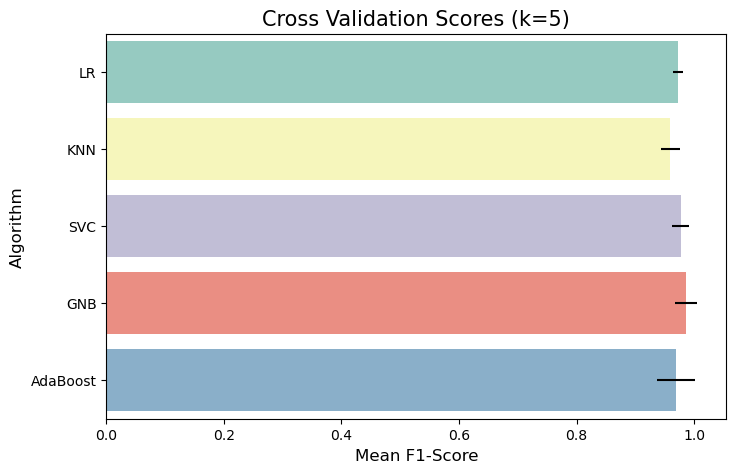

In [56]:
plt.figure(figsize = (8,5))
g = sns.barplot(data = cv_res,x="CrossValMeans",y="Algorithm", palette="Set3",orient = "h",**{'xerr':cv_std})
g.set_ylabel("Algorithm", fontsize = 12)
g.set_xlabel("Mean F1-Score", fontsize = 12)
g = g.set_title("Cross Validation Scores (k=5)", fontsize=15)
plt.show()

In [57]:
cv_res

,CrossValMeans,CrossValerrors,Algorithm
0,0.972304,0.008879,LR
1,0.959183,0.016297,KNN
2,0.976956,0.014376,SVC
3,0.986258,0.018236,GNB
4,0.968867,0.032625,AdaBoost


# Interpretation :
* Gnb has the best F1-Score


# Classifying with CFS

In [58]:
data_kidney_CFS = data_kidney.copy()
data_kidney_CFS=data_kidney_CFS.drop(columns=['su','pc','pcc','ba','rbcc','cad','age'])
data_kidney_CFS


,bp,sg,al,rbc,bgr,bu,sc,sod,pot,hemo,pcv,wbcc,htn,dm,appet,pe,ane,class
0,80.0,3,1,1,121.000000,36.0,1.2,137.528754,4.627244,15.4,44.0,7800.0,1,1,0,0,0,0
1,50.0,3,4,1,148.036517,18.0,0.8,137.528754,4.627244,11.3,38.0,6000.0,0,0,0,0,0,0
2,80.0,1,2,1,423.000000,53.0,1.8,137.528754,4.627244,9.6,31.0,7500.0,0,1,1,0,1,0
3,70.0,0,4,1,117.000000,56.0,3.8,111.000000,2.500000,11.2,32.0,6700.0,1,0,1,1,1,0
4,80.0,1,2,1,106.000000,26.0,1.4,137.528754,4.627244,11.6,35.0,7300.0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,80.0,3,0,1,140.000000,49.0,0.5,150.000000,4.900000,15.7,47.0,6700.0,0,0,0,0,0,1
396,70.0,4,0,1,75.000000,31.0,1.2,141.000000,3.500000,16.5,54.0,7800.0,0,0,0,0,0,1
397,80.0,3,0,1,100.000000,26.0,0.6,137.000000,4.400000,15.8,49.0,6600.0,0,0,0,0,0,1
398,60.0,4,0,1,114.000000,50.0,1.0,135.000000,4.900000,14.2,51.0,7200.0,0,0,0,0,0,1


In [59]:
#X_CFS = data_kidney_CFS.drop(columns=['class'],axis=1)
#y_CFS = data_kidney_CFS['class']


X_CFS = data_kidney_CFS.iloc[:,:-1].values
y_CFS = data_kidney_CFS.iloc[:,-1].values

we are going to scale CFS's X and y

In [60]:
scaler = MinMaxScaler()
X_CFS = scaler.fit_transform(X_CFS)
#X = preprocessing.StandardScaler().fit(X).transform(X)
#X = preprocessing.normalize(X)
features = ['bp','sg','al','rbc','bgr','bu',  
         'sc','sod', 'pot','hemo', 'pcv','wbcc',
         'htn','dm','appet','ane','pe']

#X_CFS[features] = scaler.fit_transform(X_CFS[features])




In [61]:
X_train, X_test, y_train, y_test = train_test_split( X_CFS, y_CFS, test_size=0.3, random_state = 0, stratify=y_CFS)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)



Train set: (280, 17) (280,)
Test set: (120, 17) (120,)


In [62]:

print('-----------------KNN-----------------')
print('')

knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

# prediction
preds = knn.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset








print('')
print('-----------------Naive Bayes -----------------')
print('')



GNB = GaussianNB()
GNB.fit(X_train, y_train)

# prediction
preds = GNB.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset


print('')
print('-----------------SVM -----------------')
print('')


# model fit
M_SVM = svm.SVC(kernel='linear')
M_SVM.fit(X_train, y_train)

# prediction
preds = M_SVM.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  


print('')
print('-----------------Logistic Regression -----------------')
print('')

# model fit
LR = LogisticRegression()
LR.fit(X_train, y_train)

# prediction
preds = LR.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  


print('')
print('-----------------Adaboost -----------------')
print('')



Ada = AdaBoostClassifier()
Ada.fit(X_train, y_train,sample_weight=None)

# prediction
preds = Ada.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  

-----------------KNN-----------------

              precision    recall  f1-score   support

           0       1.00      0.93      0.97        75
           1       0.90      1.00      0.95        45

    accuracy                           0.96       120
   macro avg       0.95      0.97      0.96       120
weighted avg       0.96      0.96      0.96       120

----------------- Overall Results -----------------
Accuracy Result: 95.83%
Precision Result: 95.00%
Recall Result: 96.67%
F1-Score Result: 95.64%

-----------------Naive Bayes -----------------

              precision    recall  f1-score   support

           0       1.00      0.92      0.96        75
           1       0.88      1.00      0.94        45

    accuracy                           0.95       120
   macro avg       0.94      0.96      0.95       120
weighted avg       0.96      0.95      0.95       120

----------------- Overall Results -----------------
Accuracy Result: 95.00%
Precision Result: 94.12%
Recall Res

# Comparing the performance of the models

## Train score and Test Score for each model

In [63]:
# Compare Algorithms

models = []
models.append(('Ada Boost', Ada, X_train, y_train, X_test, y_test))
models.append(('Logistic Regression', LR, X_train, y_train, X_test, y_test))
models.append(('KNN', knn,X_train, y_train, X_test, y_test ))
models.append(('Gaussian NB', GNB, X_train, y_train, X_test, y_test))
models.append(('SVM', M_SVM, X_train, y_train, X_test, y_test))

# evaluate each model in turn
train_scores = []
test_scores = []
names = []
ypreds = []
f1_scores = []
aucs = []
precisions = []
recalls = []

scoring = 'accuracy'
for name, mod, x_train, y_train, x_test, y_test in models:
    ypred=mod.predict(x_test)
    ypreds.append(ypred)
    precisions.append(precision_score(y_test, ypred))
    recalls.append(recall_score(y_test, ypred))
    f1_scores.append(f1_score(ypred, y_test))
    test_scores.append(mod.score(x_test,y_test))
    train_scores.append(mod.score(x_train,y_train))
    names.append(name)

In [64]:
train_df= pd.DataFrame({'Algorithms':names, 'Train Score':train_scores, 'Test Score':test_scores, 'Recall':recalls,
                        'Precision':precisions,'F1_score':f1_scores})
train_df

,Algorithms,Train Score,Test Score,Recall,Precision,F1_score
0,Ada Boost,1.000000,0.991667,1.0,0.978261,0.989011
1,Logistic Regression,0.989286,0.958333,1.0,0.900000,0.947368
2,KNN,0.992857,0.958333,1.0,0.900000,0.947368
3,Gaussian NB,0.964286,0.950000,1.0,0.882353,0.937500
4,SVM,0.992857,0.966667,1.0,0.918367,0.957447


# Interpretation :
* Adaboost has the best test score, precision and F1_score
* Adaboost has the best train score

# Roc Curve

In [65]:
# Logistic regression

y_pred_prob_lr = LR.predict(X_test)
fpr_lr, tpr_lr, thresholds_lr = roc_curve(y_test, y_pred_prob_lr)
roc_auc_lr = auc(fpr_lr, tpr_lr)
precision_lr, recall_lr, th_lr = precision_recall_curve(y_test, y_pred_prob_lr)


# Ada Boost

y_pred_prob_ada = Ada.predict(X_test)
fpr_ada, tpr_ada, thresholds_ada = roc_curve(y_test, y_pred_prob_ada)
roc_auc_ada = auc(fpr_ada, tpr_ada)
precision_ada, recall_ada, th_ada = precision_recall_curve(y_test, y_pred_prob_ada)

# SVM 

y_pred_prob_SVM =M_SVM.predict(X_test)
fpr_SVM, tpr_SVM, thresholds_SVM = roc_curve(y_test, y_pred_prob_SVM)
roc_auc_SVM = auc(fpr_SVM, tpr_SVM)
precision_SVM, recall_SVM, th_SVM = precision_recall_curve(y_test, y_pred_prob_SVM)


# KNN

y_pred_prob_KNN = knn.predict(X_test)
fpr_KNN, tpr_KNN, thresholds_KNN = roc_curve(y_test, y_pred_prob_KNN)
roc_auc_KNN = auc(fpr_KNN, tpr_KNN)
precision_KNN, recall_KNN, th_KNN = precision_recall_curve(y_test, y_pred_prob_KNN)



# Naive Bayes

y_pred_prob_nb = GNB.predict(X_test)
fpr_nb, tpr_nb, thresholds_nb = roc_curve(y_test, y_pred_prob_nb)
roc_auc_nb = auc(fpr_nb, tpr_nb)
precision_nb, recall_nb, th_nb = precision_recall_curve(y_test, y_pred_prob_nb)


# Roc Curves For each model


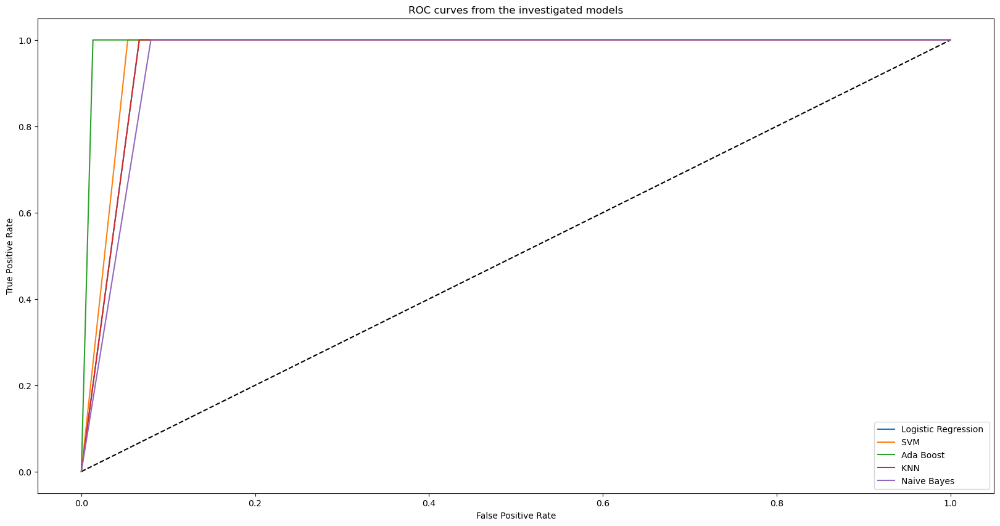

In [66]:
# Plot ROC curve
plt.figure(figsize=(20,10))
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr_lr, tpr_lr, label='Logistic Regression ' % roc_auc_lr)
plt.plot(fpr_SVM, tpr_SVM, label='SVM ' % roc_auc_SVM)
plt.plot(fpr_ada, tpr_ada, label='Ada Boost ' % roc_auc_ada)
plt.plot(fpr_KNN, tpr_KNN, label='KNN ' % roc_auc_KNN)
plt.plot(fpr_nb, tpr_nb, label='Naive Bayes ' % roc_auc_nb)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves from the investigated models')
plt.legend(loc='best')
plt.show()

In [67]:
print('SVM Area Under Curve ',roc_auc_SVM)
print('Naive Bayes ',roc_auc_nb)
print('Naive Bayes ',roc_auc_ada)


SVM Area Under Curve  0.9733333333333333
Naive Bayes  0.9600000000000001
Naive Bayes  0.9933333333333334


# Interpretation:
The black line represent the situation where True Positive Rate is equal to False Positive Rate.
All curve above this line correspond to the situation where the proportion of correctly classified points belonging to the Positive class is greater than the proportion of incorrectly classified points belonging to the Negative class.
It is evident from the plot that the Area Under Curve (AUC) for the Adaboost ROC curve is bigger than the rest. 
So, we can say that SVM did a better job of classifying the positive class in the dataset.

# Precision vs Recall

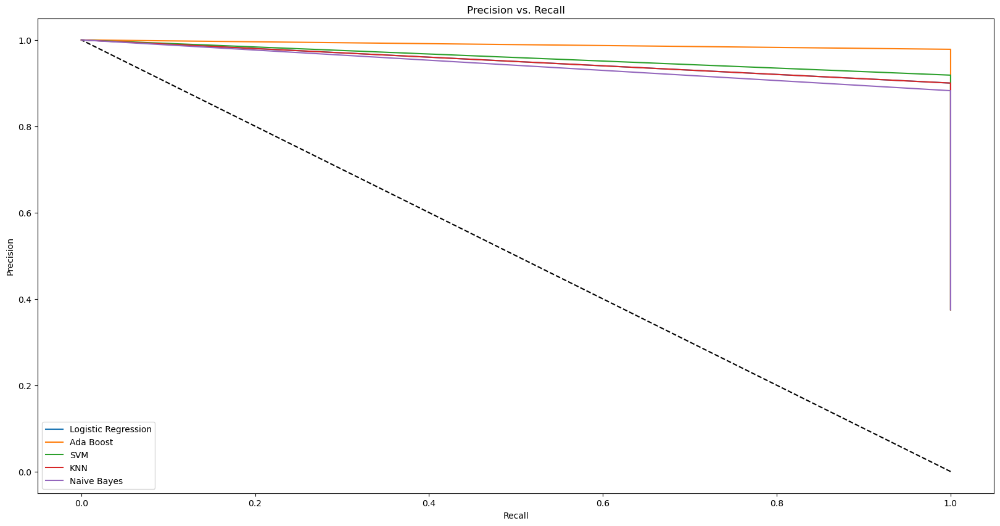

In [68]:
plt.figure(figsize=(20,10))
plt.plot([1, 0], [0, 1], 'k--')
plt.plot(recall_lr, precision_lr, label='Logistic Regression')
plt.plot(recall_ada, precision_ada, label='Ada Boost')
plt.plot(recall_SVM, precision_SVM, label='SVM')
plt.plot(recall_KNN, precision_KNN, label='KNN')
plt.plot(recall_nb, precision_nb, label='Naive Bayes')
plt.title('Precision vs. Recall')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc='best')
plt.show()

We can see that Adaboost and SVM represent the most high balanced recall and precision.

# Classifier with CFS and Adaboost

In [72]:
# model fit

print('-----------------KNN -----------------')
print('')


knn=BaggingClassifier(base_estimator=KNeighborsClassifier())
knn.fit(X_train,y_train)

# prediction

prediction=knn.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']



print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset









print('')
print('-----------------Naive Bayes -----------------')
print('')



Ada_CFS_GNB = AdaBoostClassifier(base_estimator=GaussianNB(),algorithm='SAMME')
Ada_CFS_GNB.fit(X_train, y_train)

# prediction
preds = Ada_CFS_GNB.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']



print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset


print('')
print('-----------------SVM -----------------')
print('')



# model fit
Ada_CFS_SVM = AdaBoostClassifier(base_estimator=SVC(gamma=0.1, C=1000),algorithm='SAMME')
Ada_CFS_SVM.fit(X_train, y_train)

# prediction
preds = Ada_CFS_SVM.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset

-----------------KNN -----------------

              precision    recall  f1-score   support

           0       1.00      0.97      0.99        75
           1       0.96      1.00      0.98        45

    accuracy                           0.98       120
   macro avg       0.98      0.99      0.98       120
weighted avg       0.98      0.98      0.98       120

----------------- Overall Results -----------------
Accuracy Result: 98.33%
Precision Result: 97.87%
Recall Result: 98.67%
F1-Score Result: 98.24%

-----------------Naive Bayes -----------------

              precision    recall  f1-score   support

           0       1.00      0.92      0.96        75
           1       0.88      1.00      0.94        45

    accuracy                           0.95       120
   macro avg       0.94      0.96      0.95       120
weighted avg       0.96      0.95      0.95       120

----------------- Overall Results -----------------
Accuracy Result: 95.00%
Precision Result: 94.12%
Recall Re

# Balanced Data

In [172]:
!pip install -U imbalanced-learn

In [73]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

Before OverSampling, counts of label '1': 105
Before OverSampling, counts of label '0': 175 



In [74]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
x_train_res, y_train_res = oversample.fit_resample(X_train, y_train)

In [78]:
x_train_res.shape

(280, 17)

In [75]:
print('After OverSampling, the shape of train_X: {}'.format(x_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

After OverSampling, the shape of train_X: (350, 17)
After OverSampling, the shape of train_y: (350,) 

After OverSampling, counts of label '1': 175
After OverSampling, counts of label '0': 175


In [79]:
print('-----------------KNN-----------------')
print('')

knn = KNeighborsClassifier()

knn.fit(x_train_res, y_train_res)

# prediction
preds = knn.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset





print('')
print('-----------------Naive Bayes -----------------')
print('')



GNB = GaussianNB()
GNB.fit(x_train_res, y_train_res)

# prediction
preds = GNB.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))      # F1-Score of the whole Dataset


print('')
print('-----------------SVM -----------------')
print('')


# model fit
M_SVM = svm.SVC(kernel='linear')
M_SVM.fit(x_train_res, y_train_res)

# prediction
preds = M_SVM.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  


print('')
print('-----------------Logistic Regression -----------------')
print('')

# model fit
LR = LogisticRegression()
LR.fit(x_train_res, y_train_res)

# prediction
preds = LR.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']


print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  


print('')
print('-----------------Adaboost -----------------')
print('')



Ada = AdaBoostClassifier()
Ada.fit(x_train_res, y_train_res,sample_weight=None)

# prediction
preds = Ada.predict(X_test)
print(classification_report(y_test, preds))

acc = accuracy_score(y_test, preds)
results_all = precision_recall_fscore_support(y_test, preds, average='macro', zero_division=1)
results_class = precision_recall_fscore_support(y_test, preds, average=None, zero_division=1)
metric_columns = ['Precision','Recall', 'F1-Score','S']
all_df = pd.concat([pd.DataFrame(list(results_class)).T,pd.DataFrame(list(results_all)).T])
all_df.columns = metric_columns
all_df.index = classes+['Total']

print('----------------- Overall Results -----------------')
print('Accuracy Result: %.2f%%'%(acc*100))                   # Accuracy of the whole Dataset
print('Precision Result: %.2f%%'%(all_df.iloc[2,0]*100))     # Precision of the whole Dataset
print('Recall Result: %.2f%%'%(all_df.iloc[2,1]*100))        # Recall of the whole Dataset
print('F1-Score Result: %.2f%%'%(all_df.iloc[2,2]*100))  

-----------------KNN-----------------

              precision    recall  f1-score   support

           0       1.00      0.93      0.97        75
           1       0.90      1.00      0.95        45

    accuracy                           0.96       120
   macro avg       0.95      0.97      0.96       120
weighted avg       0.96      0.96      0.96       120

----------------- Overall Results -----------------
Accuracy Result: 95.83%
Precision Result: 95.00%
Recall Result: 96.67%
F1-Score Result: 95.64%

-----------------Naive Bayes -----------------

              precision    recall  f1-score   support

           0       1.00      0.92      0.96        75
           1       0.88      1.00      0.94        45

    accuracy                           0.95       120
   macro avg       0.94      0.96      0.95       120
weighted avg       0.96      0.95      0.95       120

----------------- Overall Results -----------------
Accuracy Result: 95.00%
Precision Result: 94.12%
Recall Res

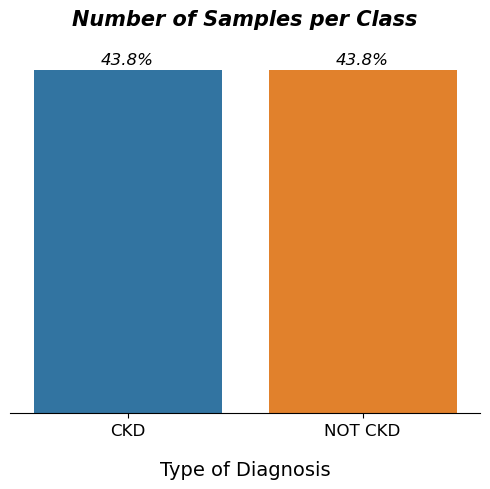

In [121]:
plt.figure(figsize=(5, 5))

sns.countplot(x = y_train_res)
sns.despine(top=True, right=True, left=True, bottom=False)

plt.xticks(ticks= [0,1], labels=['CKD', 'NOT CKD'], fontsize=12)
plt.yticks([])
plt.title('Number of Samples per Class' , fontsize=15 , pad=20 , fontstyle='italic' , fontweight = 800)
plt.xlabel('Type of Diagnosis' , fontsize=14 , fontweight=400, labelpad=16)
plt.ylabel('')
ax = plt.gca()

for p in ax.patches:
    ax.annotate("%.1f%%" % (100*float(p.get_height()/data_kidney.shape[0])), (p.get_x() + p.get_width() / 2., abs(p.get_height())), ha='center', 
                va='bottom', color='black', xytext=(0,2), rotation='horizontal', textcoords='offset points', fontsize = 12, fontstyle = 'italic')

# plt.savefig("samples.png")
plt.tight_layout()